# Visualization Analysis of ICESat-2 Glacier Elevation Changes

This notebook integrates all data visualization code related to ICESat-2, including time series analysis, spatial distribution, and elevation band analysis.

**Author**: Refactored from original code  
**Date**: 2024  
**Data Sources**: ICESat, ICESat-2, CryoSat-2, GRACE

---

## 1. Import Functions and Libraries

This section imports all necessary Python libraries, including those for data processing, statistical analysis, geospatial analysis, and visualization.

In [145]:
# 基础数据处理
import pandas as pd
import numpy as np
from datetime import datetime as dt
import time
import datetime
import os

# 统计分析
from statsmodels.tsa.seasonal import STL
import statsmodels.api as sm
from statsmodels.robust.robust_linear_model import RLM
from hampel import hampel
import pwlf

# 可视化
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as mcolors
import matplotlib.patches as patches
import matplotlib.ticker as mticker
from mpl_toolkits.axes_grid1.inset_locator import mark_inset, inset_axes
import seaborn as sns

# 地理空间分析
import geopandas as gpd
import cartopy.crs as ccrs
import cartopy.feature as cfeat
import cartopy.io.img_tiles as cimgt
from cartopy.mpl.gridliner import LONGITUDE_FORMATTER, LATITUDE_FORMATTER
from cartopy.mpl.ticker import LongitudeFormatter, LatitudeFormatter

# 设置样式
plt.rcParams['axes.unicode_minus'] = False
sns.set(style="ticks")

plt.rcParams['font.family'] = 'Arial'
plt.rcParams['pdf.fonttype'] = 42 
plt.rcParams['ps.fonttype'] = 42 

print("✓ 所有库导入成功")


✓ 所有库导入成功


### 1.1 Define tools


In [2]:
def toYearFraction(date):
    """
    将日期转换为年份的小数表示
    
    Parameters:
    -----------
    date : datetime
        输入的日期时间对象
    
    Returns:
    --------
    float
        年份的小数表示 (例如: 2020.5 表示2020年中)
    """
    def sinceEpoch(date):
        return time.mktime(date.timetuple())
    
    s = sinceEpoch
    year = date.year
    startOfThisYear = dt(year=year, month=1, day=1)
    startOfNextYear = dt(year=year+1, month=1, day=1)
    
    yearElapsed = s(date) - s(startOfThisYear)
    yearDuration = s(startOfNextYear) - s(startOfThisYear)
    fraction = yearElapsed / yearDuration
    
    return date.year + fraction

---

## 2. Data Loading Module

This section is responsible for loading all necessary data files, including ICESat, ICESat-2, CryoSat-2, and GRACE data.

### 2.1 Load Satellite Altimetry Data (Regional Scale)

In [ ]:
# ICESat数据加载
print("加载ICESat数据...")
icesat = pd.read_excel(
    'G:/HMA/ICESat_Result/ICESat_result_20230605.xlsx',
    sheet_name='task_new', header=64, nrows=18, usecols='A:AZ'
)
std1 = pd.read_excel(
    'G:/HMA/ICESat_Result/ICESat_result_20230605.xlsx',
    sheet_name='task_new', header=40, nrows=18, usecols='A:AZ'
)
num1 = pd.read_excel(
    'G:/HMA/ICESat_Result/ICESat_result_20230605.xlsx',
    sheet_name='task_new', header=85, nrows=18, usecols='A:AZ'
)

# ICESat-2数据加载 (高度带校正)
print("加载ICESat-2数据...")
icesat2 = pd.read_excel(
    "G:/HMA/ICESat2_Result/ICESat2_Result_20231018.xlsx",
    sheet_name='season_mean_pdd_ele_band', header=0, nrows=55, usecols='A:AZ'
)
std2 = pd.read_excel(
    "G:/HMA/ICESat2_Result/ICESat2_Result_20231018.xlsx",
    sheet_name='season_mean_pdd', header=121, nrows=55, usecols='A:AZ'
)
num2 = pd.read_excel(
    "G:/HMA/ICESat2_Result/ICESat2_Result_20231018.xlsx",
    sheet_name='season_mean_pdd_ele_band', header=59, nrows=55, usecols='A:AZ'
)

# CryoSat-2数据加载
print("加载CryoSat-2数据...")
cryosat2 = pd.read_excel(
    'G:/HMA/CryoSat2_Result/CryoSat2_result_20230604.xlsx',
    sheet_name='3month_ele_band', header=0, nrows=150, usecols='A:AZ'
)
std3 = pd.read_excel(
    'G:/HMA/CryoSat2_Result/CryoSat2_result_20230604.xlsx',
    sheet_name='3month_new', header=304, nrows=150, usecols='A:AZ'
)
num3 = pd.read_excel(
    'G:/HMA/CryoSat2_Result/CryoSat2_result_20230604.xlsx',
    sheet_name='3month_ele_band', header=152, nrows=150, usecols='A:AZ'
)

# GRACE TWS数据
print("加载GRACE TWS数据...")
tws = pd.read_excel(
    'G:/HMA/GRACE_RL06/TWS_HMA_SSA.xlsx',
    sheet_name='tws', header=499, nrows=255, usecols='D:BA'
)

# 加载区域和校正参数
print("加载区域参数和校正数据...")
area = pd.read_excel(
    'G:/HMA/测高结果20231109.xlsx',
    sheet_name='static_new', header=0, nrows=4, usecols='B:AY'
)
correction = pd.read_excel(
    'G:/HMA/测高结果20231109.xlsx',
    sheet_name='static_new', header=49, nrows=3, usecols='B:AY'
)

head = area.columns.to_list()

print(f"✓ 区域尺度数据加载完成")
print(f"  - ICESat: {icesat.shape}")
print(f"  - ICESat-2: {icesat2.shape}")
print(f"  - CryoSat-2: {cryosat2.shape}")
print(f"  - 分析区域数: {len(head)}")


### 2.2 Load Grid-Scale ICESat-2 Data (Core Content of HMA_grid_series_compute.py)

In [3]:
# 加载网格尺度的ICESat-2数据（包含高度带信息）
print("加载网格尺度ICESat-2数据...")
data_grid_ele = pd.read_excel(
    r"E:\revised_NCC_data\ICESat2_result\ICESat2_seasonal_elevation_results.xlsx",
    sheet_name='month_value', header=0,
)
data_grid_num = pd.read_excel(
    r"E:\revised_NCC_data\ICESat2_result\ICESat2_seasonal_elevation_results.xlsx",
    sheet_name='month_count', header=0,
)

ele_grid = data_grid_ele[['days','date'] + np.arange(1,497).tolist()]
num_grid = data_grid_num[['days','date'] + np.arange(1,497).tolist()]

# 转换日期为年份小数
for k in range(len(ele_grid['date'])):
    ele_grid['days'].iloc[k] = toYearFraction(ele_grid['date'].iloc[k])
    num_grid['days'].iloc[k] = toYearFraction(num_grid['date'].iloc[k])

ele_grid['days'] = ele_grid['days'].astype(float)
num_grid['days'] = num_grid['days'].astype(float)
ele_grid = ele_grid.reset_index(drop=True)
num_grid = num_grid.reset_index(drop=True)

# 加载网格面积数据
area_grid = pd.read_excel(
    "E:/HMA/HMA高度带.xlsx",
    sheet_name='grid10_100_496', header=0, nrows=66, usecols='A:SC'
)

print(f"✓ 网格尺度数据加载完成")
print(f"  - 网格数量: {len(ele_grid.columns)-2}")
print(f"  - 时间序列长度: {len(ele_grid)}")


加载网格尺度ICESat-2数据...
✓ 网格尺度数据加载完成
  - 网格数量: 496
  - 时间序列长度: 82


C:\Users\Administrator\AppData\Local\Temp\ipykernel_30332\3806469770.py:17: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  ele_grid['days'].iloc[k] = toYearFraction(ele_grid['date'].iloc[k])
C:\Users\Administrator\AppData\Local\Temp\ipykernel

### 2.3 Load Geospatial Data

In [26]:
# 研究区边界
print("加载地理空间数据...")
studyregion = gpd.read_file("E:/HMA/HMA_boundary/HMA_one.shp")

# 网格
grids = gpd.read_file(r"E:\revised_NCC_data\grid10_pdd\HMA_fishnet_10_clip_coreg_filled.shp")

# 子区域
subregion = gpd.read_file(
    "E:/HMA_subregion/regions_hma_v03_zheng/"
    "boundary_mountain_regions_hma_v3_zheng_20200601.shp"
)

# 冰川
glacier = gpd.read_file("E:/HMA/Hugonnet/per_glacier/rgi_hma.shp")

# 河流
river2 = gpd.read_file(r"E:\HMA_subregion\河网\三级以上河流\hyd2_4l.shp")

print("✓ 地理空间数据加载完成")
print(f"  - 研究区: {len(studyregion)} 个多边形")
print(f"  - 网格: {len(grids)} 个")
print(f"  - 子区域: {len(subregion)} 个")
print(f"  - 冰川: {len(glacier)} 条")


加载地理空间数据...
✓ 地理空间数据加载完成
  - 研究区: 1 个多边形
  - 网格: 496 个
  - 子区域: 22 个
  - 冰川: 95536 条


---

## 3. Time Series Analysis Module (Core Functionality of series_plot_1120.py)

This section includes regional-scale time series analysis and visualization functions, integrating data from three satellites: ICESat, ICESat-2, and CryoSat-2.

### 3.1 Single-Region Time Series Plotting Function

In [5]:
def plot_region_timeseries(region_index, save_path=None, show_correction=True):
    """
    绘制单个区域的ICESat-2时间序列（含ICESat和CryoSat-2）
    
    Parameters:
    -----------
    region_index : int
        区域索引 (0-38, 0为HMA整体, 38为TP)
    save_path : str, optional
        图片保存路径
    show_correction : bool
        是否应用高程偏差校正
    
    功能说明：
    - 绘制三个卫星的原始数据和STL趋势分解结果
    - 包含3σ不确定性范围
    - 叠加GRACE TWS异常数据
    - 计算并显示线性趋势和质量平衡
    """
    i = head[region_index]
    
    # 数据过滤和STL趋势分解
    # ICESat
    mask1 = num1[i] >= 20
    icesati = icesat[i].where(mask1).dropna(axis=0, how='all')
    std1i = std1[i].where(mask1).dropna(axis=0, how='all')
    time1i = icesat['year'].where(mask1).dropna(axis=0, how='all')
    trend1i = STL(icesati, period=3).fit().trend
    
    # ICESat-2
    mask2 = num2[i] >= 1000
    icesat2i = icesat2[i].where(mask2).dropna(axis=0, how='all')
    std2i = std2[i].where(mask2).dropna(axis=0, how='all')
    time2i = icesat2['year'].where(mask2).dropna(axis=0, how='all')
    trend2i = STL(icesat2i, period=12).fit().trend
    
    # CryoSat-2
    mask3 = num3[i] >= 1000
    cryosat2i = cryosat2[i].where(mask3).dropna(axis=0, how='all')
    std3i = std3[i].where(mask3).dropna(axis=0, how='all')
    time3i = cryosat2['year'].where(mask3).dropna(axis=0, how='all')
    trend3i = STL(cryosat2i, period=12).fit().trend
    
    # 应用校正
    if show_correction:
        corr = correction[i][0]
        corr2 = correction[i][1]
        corr3 = correction[i][2]
    else:
        corr = corr2 = corr3 = 0
    
    # 合并时间序列并计算趋势
    timeall = time1i.append(time2i).append(time3i)
    series = (trend1i + corr3).append(trend2i).append(trend3i + corr)
    stdall = std1i.append(std2i).append(std3i)
    
    for k in range(len(timeall)):
        timeall.iloc[k] = toYearFraction(timeall.iloc[k])
    timeall = timeall.astype(float)
    subregion = pd.concat([timeall, series, stdall], axis=1)
    
    # 加权最小二乘回归
    X = sm.add_constant(subregion['year'].values)
    model = sm.WLS(subregion['trend'].values, X, subregion.iloc[:, 2])
    results = model.fit()
    
    slope = results.params[1]
    slope_err = results.bse[1]
    
    # 计算质量平衡
    mass = slope * area[i][1] * 0.85 / 1000
    mass_err = np.sqrt(
        (slope_err * 0.85 * area[i][1])**2 + 
        (slope * 0.06 * area[i][1])**2 + 
        (slope * 0.85 * area[i][1] * 0.1)**2
    ) / 1000
    
    # 绘图
    fig = plt.figure(figsize=(5, 4), dpi=300)
    ax = plt.subplot(1, 1, 1)
    
    # 绘制数据点和不确定性
    plt.plot(time1i, icesati + corr3, '^-', color=plt.cm.Accent(0), 
             linewidth=1.5, markersize=3, label='ICESat')
    plt.fill_between(time1i, icesati + corr3 - 3*std1i, 
                     icesati + corr3 + 3*std1i, color='gray', alpha=0.2)
    
    plt.plot(time3i, cryosat2i + corr, 's-', color=plt.cm.Accent(1), 
             linewidth=1.5, markersize=3, label='CryoSat-2')
    plt.fill_between(time3i, cryosat2i + corr - 3*std3i, 
                     cryosat2i + corr + 3*std3i, color='gray', alpha=0.2)
    
    plt.plot(time2i, icesat2i, 'o-', color=plt.cm.Accent(2), 
             linewidth=1.5, markersize=3, label='ICESat-2')
    plt.fill_between(time2i, icesat2i - 3*std2i, 
                     icesat2i + 3*std2i, color='gray', alpha=0.2)
    
    # TWS异常
    plt.plot(tws['date'], tws[i]*area[i][0]/85/area[i][1] + corr2, 
             '-', color=plt.cm.Accent(7), linewidth=2, label='TWS anomaly')
    
    # 趋势线
    plt.plot(time1i, trend1i + corr3, '-', color=plt.cm.Accent(4), 
             linewidth=3, label='ICESat trend')
    plt.plot(time3i, trend3i + corr, '-', color=plt.cm.Accent(5), 
             linewidth=3, label='CryoSat-2 trend')
    plt.plot(time2i, trend2i, '-', color=plt.cm.Accent(6), 
             linewidth=3, label='ICESat-2 trend')
    
    # 设置
    text = i[0:-2] if i.rfind('.1') > 0 else i
    ax.set_ylim([-20, 7])
    plt.grid(axis='y', color='gray', linestyle='--', linewidth=0.3)
    plt.title(text, y=1.0, fontdict=dict(fontsize=16, color='black', 
                                          family='Arial', weight='bold', alpha=1.0))
    
    # 添加文本信息
    plt.text(0.28, 0.08, f'{slope:.2f} ± {slope_err:.3f} m/yr', 
             ha='center', va='baseline', transform=ax.transAxes,
             fontdict=dict(fontsize=16, color='black', family='Arial', 
                          weight='normal', alpha=0.8), stretch='expanded')
    
    if save_path:
        if i.rfind('/') > 0:
            i = i.replace('/', '_')
        plt.savefig(save_path, dpi=600, bbox_inches='tight')
    
    plt.show()
    
    return {'slope': slope, 'slope_err': slope_err, 'mass': mass, 'mass_err': mass_err}



✓ 时间序列绘图函数定义完成


### 3.2 Example: Plotting Time Series for a Single Region

In [ ]:
# 示例：绘制HMA整体的时间序列
# result = plot_region_timeseries(
#     region_index=0,  # HMA整体
#     save_path='G:/HMA/map/timeseries/HMA.png',
#     show_correction=True
# )
# print(f"趋势: {result['slope']:.3f} ± {result['slope_err']:.3f} m/yr")
# print(f"质量平衡: {result['mass']:.2f} ± {result['mass_err']:.2f} Gt/yr")


### 3.3 ICESat-2 Time Series Visualization (Core Functionality of ICESat2_series.py)

This section focuses on outlier detection and visualization for single-satellite ICESat-2 data, utilizing Hampel filtering and trend-filling methods to identify extreme events.

In [150]:
def plot_icesat2_timeseries(region_index, trend_results, ele_results, uncert_results, year_results, save_path=None):
    """
    绘制ICESat-2时间序列可视化
    
    Parameters:
    -----------
    region_index : int
        区域索引
    save_path : str, optional
        保存路径
    trend_results : dataframe: num_regions*[Slope, Pvalue, CI/2, Intercept]
    ele_results: dataframe: time*num_regions
    uncert_results: 标准误
    """
    
    head_ice2 = ele_results.columns.tolist()[2:]
    region_name = head_ice2[region_index]

    k = trend_results.loc[region_name, 'Slope']
    b = trend_results.loc[region_name, 'Intercept']
    pvalue = trend_results.loc[region_name, 'Pvalue']
    CIhalf = trend_results.loc[region_name, 'CI/2']
    if pd.isna(k):
        print(f'[{region_index}: {region_name}] No valid obs.')
        return
    
    # 绘图
    fig, ax = plt.subplots(figsize=(5, 4), dpi=600)
    
    # 原始数据
    l1 = ax.plot(ele_results['days'], ele_results[region_name], '.-', linewidth=2, 
                  markersize=10, label='Original')
    ax.fill_between(ele_results['days'], ele_results[region_name] - uncert_results[region_name], 
                     ele_results[region_name] + uncert_results[region_name], color='gray', alpha=0.2)

    #年尺度数据
    year_results_copy = year_results.copy().dropna(subset=[region_name])
    year_results_copy['year'] = (year_results_copy['start_year']+year_results_copy['end_year(not included)'])/2
    year_results_copy['year'] = year_results_copy['year'].astype(float)
    
    # 绘制annual
    l2 = ax.plot(year_results_copy['year'], year_results_copy[region_name], 
                  '-', linewidth=1.5, color='orange', 
                  label='Annual')
    # 绘制趋势线
    l3 = ax.plot([ele_results['days'].min(), ele_results['days'].max()], 
                    [ele_results['days'].min()*k+b, ele_results['days'].max()*k+b],
                  '--', linewidth=1.5, color='k', alpha=0.8,
                  label='Trend')
    
    if '.1' in region_name:
        title_name = region_name.replace('.1', '')
    else:
        title_name = region_name
    ax.set_title(title_name, fontweight='bold', fontsize=18)
    ax.legend(fontsize=14, loc='best')
    ax.autoscale(tight=True)

    ax.set_ylim([np.min(ele_results[region_name]) - 0.2*(np.max(ele_results[region_name]) - np.min(ele_results[region_name])),
                 np.max(ele_results[region_name]) + 0.2*(np.max(ele_results[region_name]) - np.min(ele_results[region_name]))])
    ax.set_xlim([2018.5, 2025.7])
    ax.set_ylabel(r'Elevation change / m', fontsize=16, labelpad=0)
    ax.set_xlabel(r'Year', fontsize=16, labelpad=0)
    ax.tick_params(labelsize=14)
    
    plt.text(2021.5, np.min(ele_results[region_name]) - 0.15*(np.max(ele_results[region_name]) - np.min(ele_results[region_name])),
             f'k = {k:.2f} ± {CIhalf:.2f} m/yr\n$p$ = {pvalue:.2f}', va='baseline',
             fontdict=dict(fontsize=14, color='k'))
    
    plt.grid(axis='y', linestyle='--', linewidth=0.3)
    
    if save_path:
        plt.savefig(save_path, dpi=600, bbox_inches='tight')
    
    plt.show()


In [114]:
# 加载ICESat-2季节数据（高度带校正版本）
data_icesat2 = pd.read_excel(
    r"E:\revised_NCC_data\ICESat2_result\ICESat2_seasonal_elevation_results.xlsx",
    sheet_name='month_value', header=0, usecols='A:AO'
)
num_icesat2 = pd.read_excel(
    r"E:\revised_NCC_data\ICESat2_result\ICESat2_seasonal_elevation_results.xlsx",
    sheet_name='month_count', header=0, usecols='A:AO'
)
uncert_icesat2 = pd.read_excel(
    r"E:\revised_NCC_data\ICESat2_result\ICESat2_seasonal_elevation_results.xlsx",
    sheet_name='month_uncert', header=0, usecols='A:AO'
)

data_icesat2_year = pd.read_excel(
    r"E:\revised_NCC_data\ICESat2_result\ICESat2_yearly_elevation_results.xlsx",
    sheet_name='year_value', header=0, usecols='A:AO'
).iloc[0:6]
uncert_icesat2_year = pd.read_excel(
    r"E:\revised_NCC_data\ICESat2_result\ICESat2_yearly_elevation_results.xlsx",
    sheet_name='year_uncert', header=0, usecols='A:AO'
).iloc[0:6]

head_ice2 = data_icesat2.columns.tolist()[2:]

# 转换年份
for k in range(len(data_icesat2)):
    data_icesat2.loc[k, 'days'] = toYearFraction(data_icesat2.loc[k, 'date'])
    num_icesat2.loc[k, 'days'] = toYearFraction(num_icesat2.loc[k, 'date'])
    uncert_icesat2.loc[k, 'days'] = toYearFraction(uncert_icesat2.loc[k, 'date'])

data_icesat2['days'] = data_icesat2['days'].astype(float)
uncert_icesat2['days'] = uncert_icesat2['days'].astype(float)

C:\Users\Administrator\AppData\Local\Temp\ipykernel_30332\441628329.py:28: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '2018.8739726027397' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  data_icesat2.loc[k, 'days'] = toYearFraction(data_icesat2.loc[k, 'date'])
C:\Users\Administrator\AppData\Local\Temp\ipykernel_30332\441628329.py:29: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '2018.8739726027397' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  num_icesat2.loc[k, 'days'] = toYearFraction(num_icesat2.loc[k, 'date'])
C:\Users\Administrator\AppData\Local\Temp\ipykernel_30332\441628329.py:30: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '2018.8739726027397' has 

In [123]:
trend_results, seasonal_hampel_results = calculate_grid_trends(data_icesat2, num_icesat2)

d:\Anaconda\install\envs\gee_dask\Lib\site-packages\hampel.py:49: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  rolling_median = rolling_ts.median().fillna(method='bfill').fillna(method='ffill')
d:\Anaconda\install\envs\gee_dask\Lib\site-packages\hampel.py:50: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  rolling_sigma = k*(rolling_ts.apply(median_absolute_deviation).fillna(method='bfill').fillna(method='ffill'))
d:\Anaconda\install\envs\gee_dask\Lib\site-packages\hampel.py:49: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  rolling_median = rolling_ts.median().fillna(method='bfill').fillna(method='ffill')
d:\Anaconda\install\envs\gee_dask\Lib\site-packages\hampel.py:50: FutureWarning: Series.fillna with 'method' is deprecate

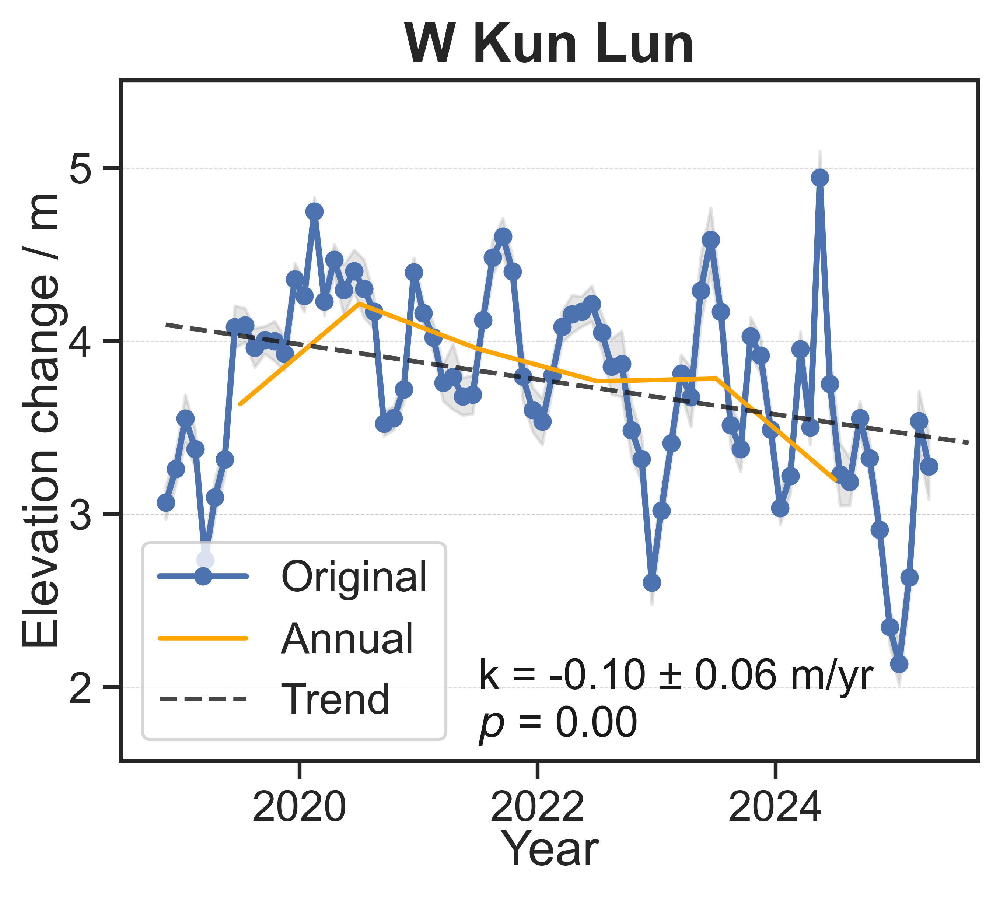

In [143]:
plot_icesat2_timeseries(region_index=5,
                        trend_results=trend_results,
                        ele_results=seasonal_hampel_results,
                        uncert_results=uncert_icesat2,
                        year_results=data_icesat2_year,
                        save_path=None)

### 3.4 Example: Plotting ICESat-2 Time Series for All HMA Regions

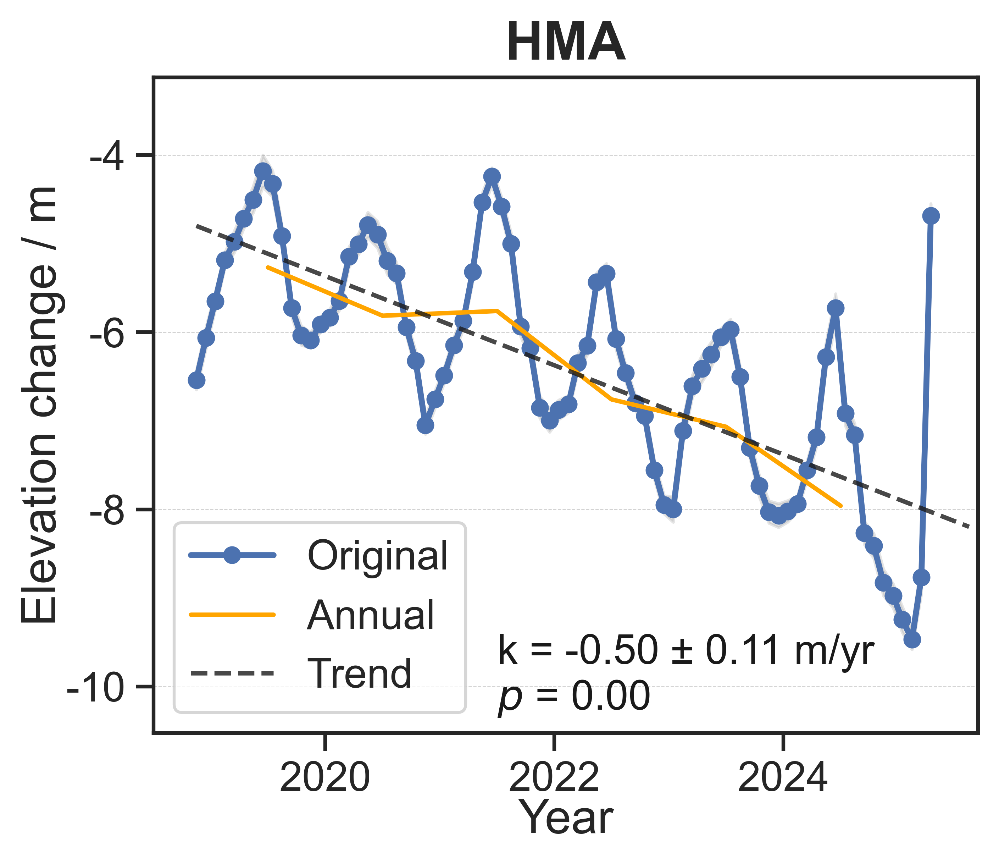

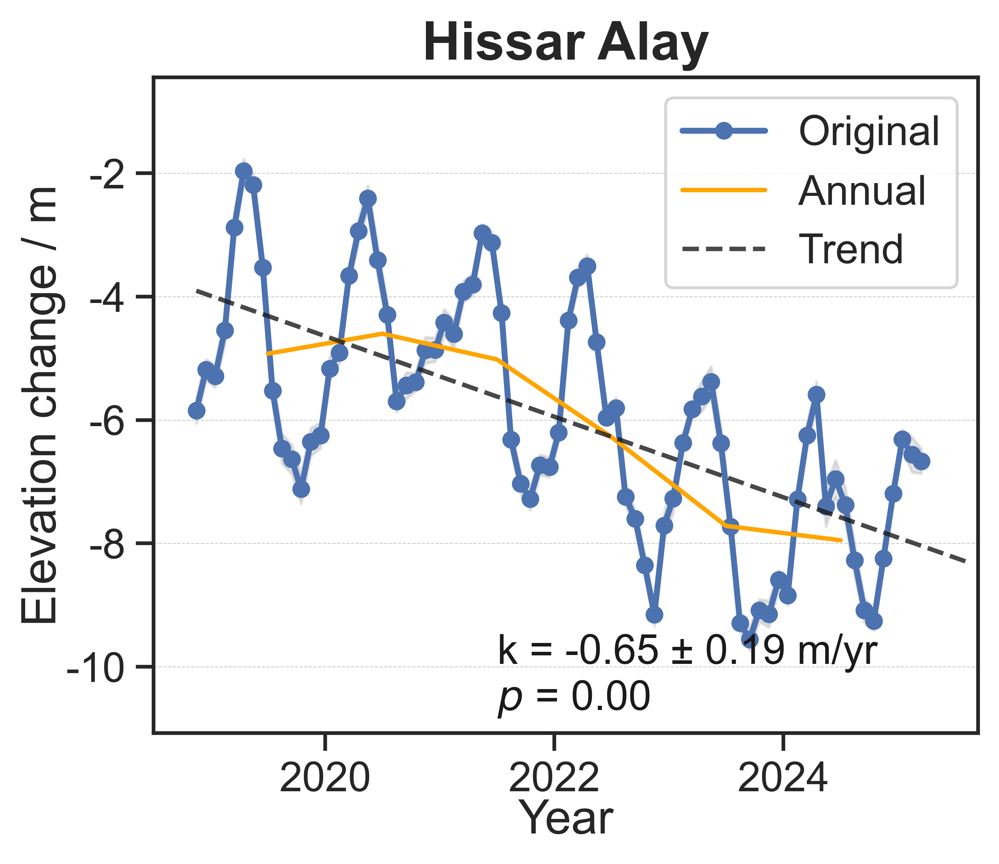

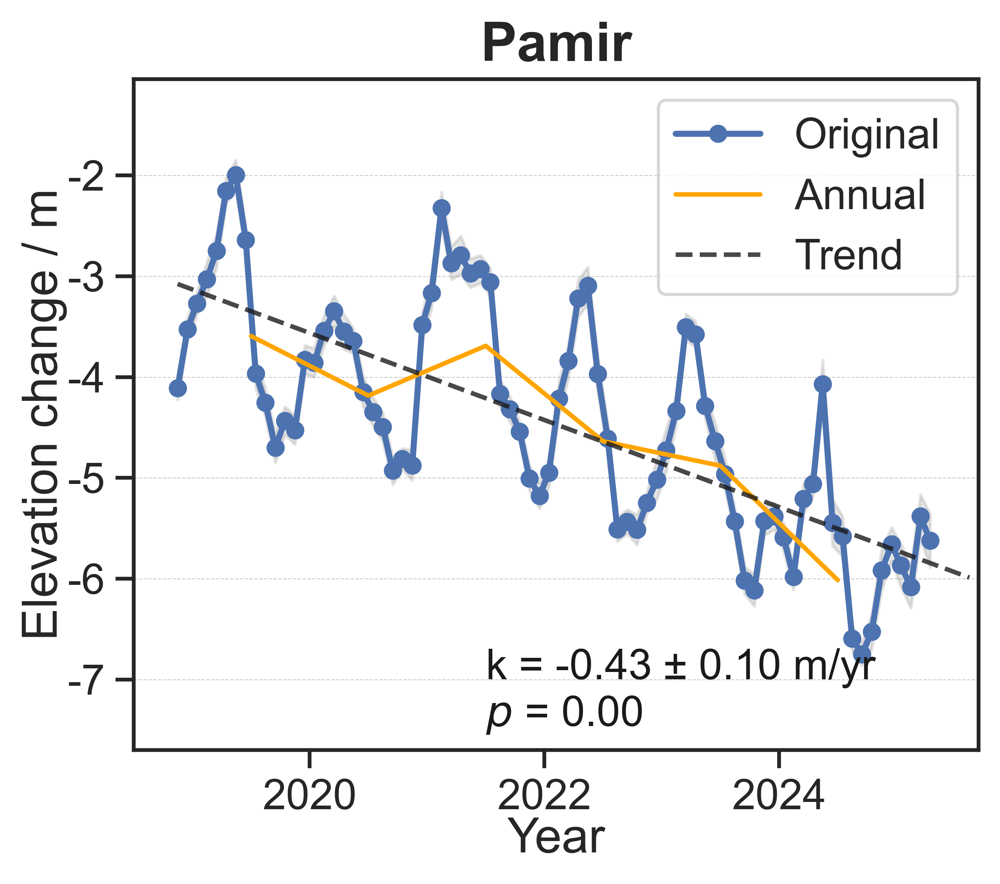

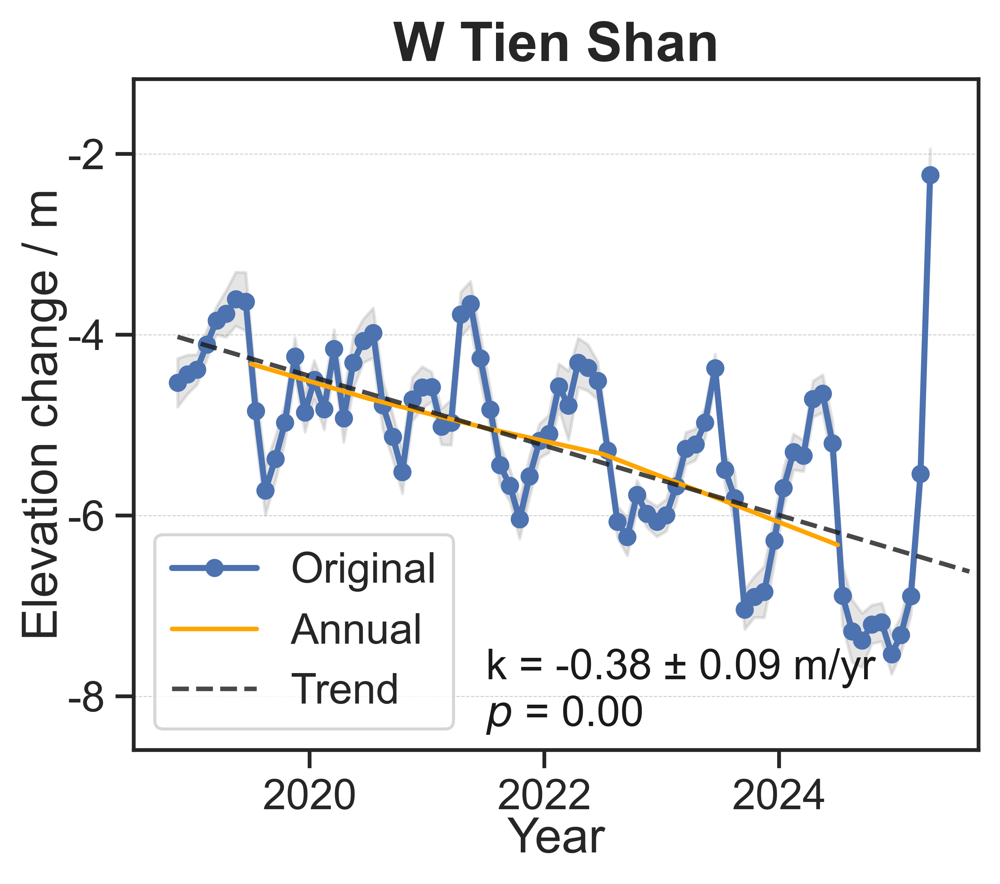

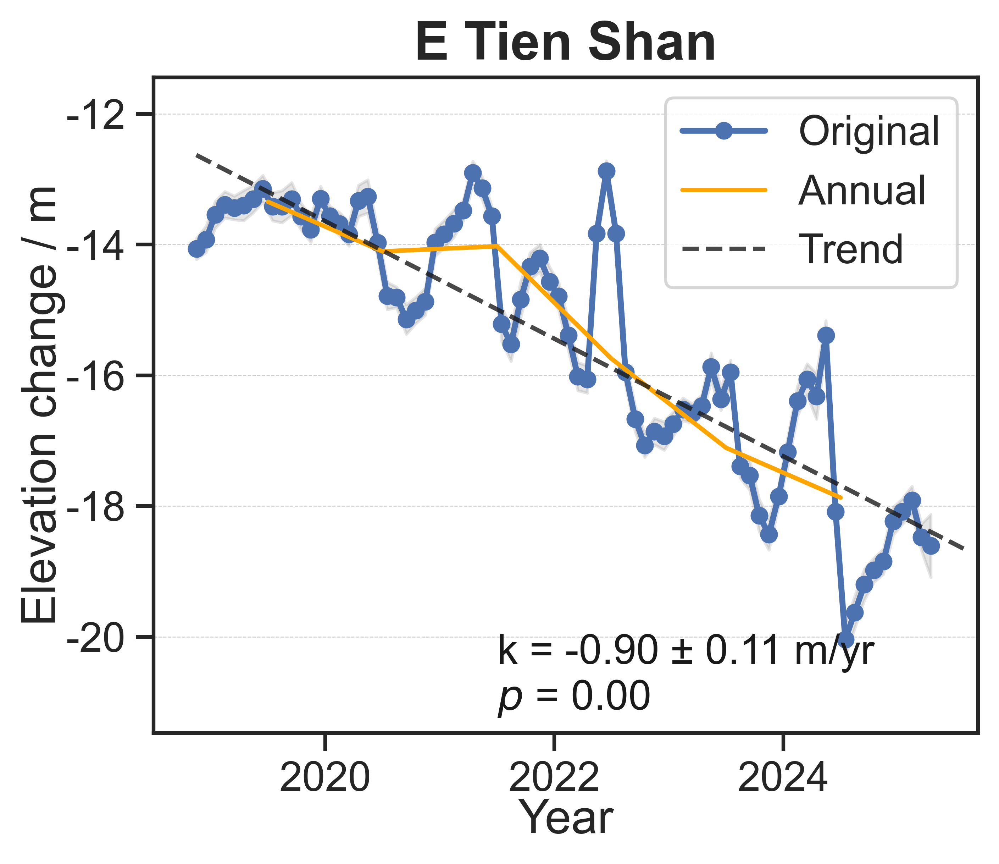

...

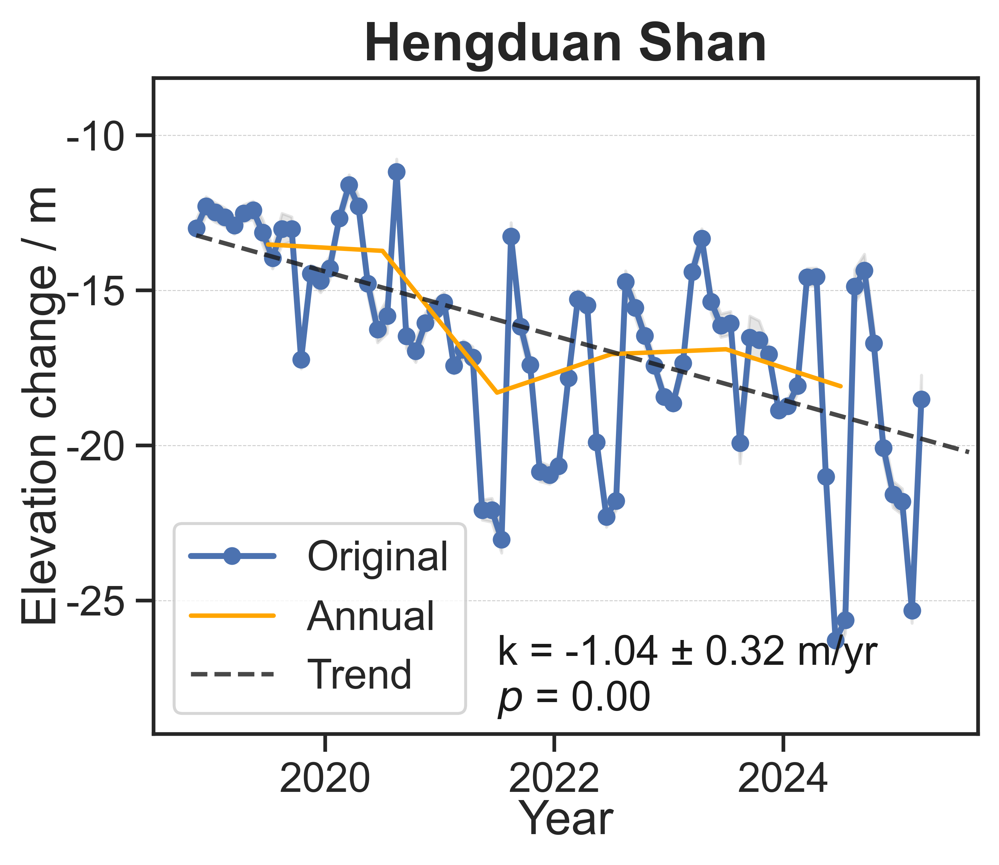

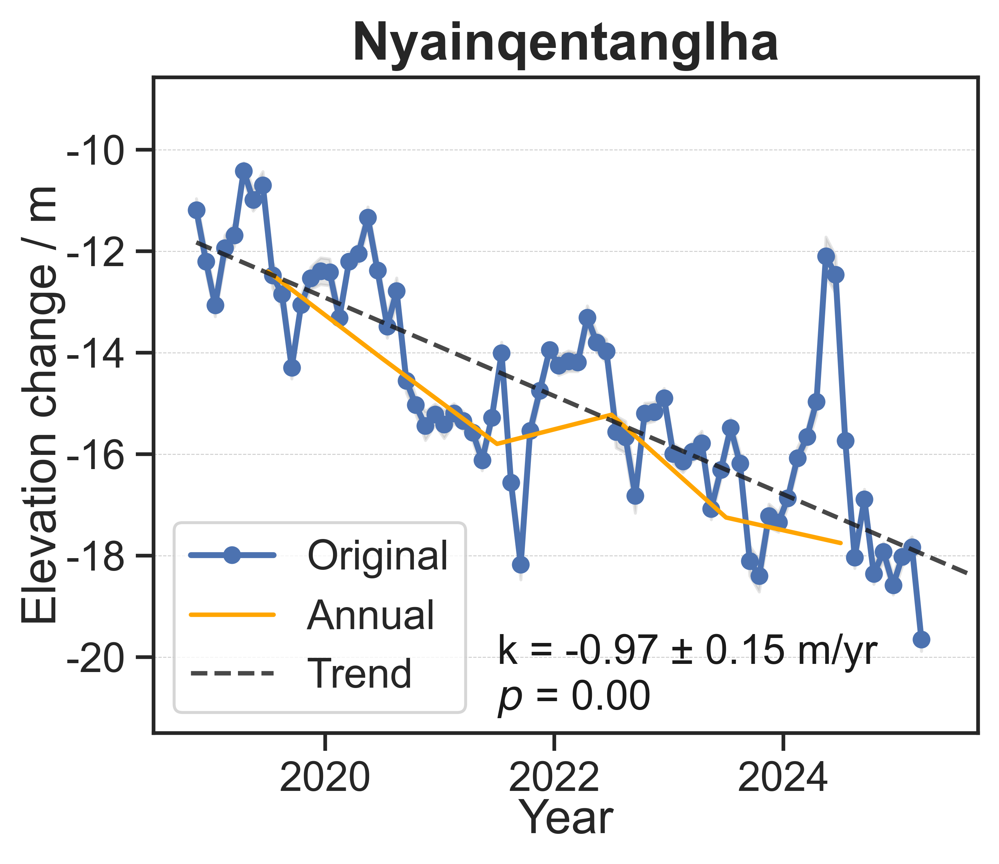

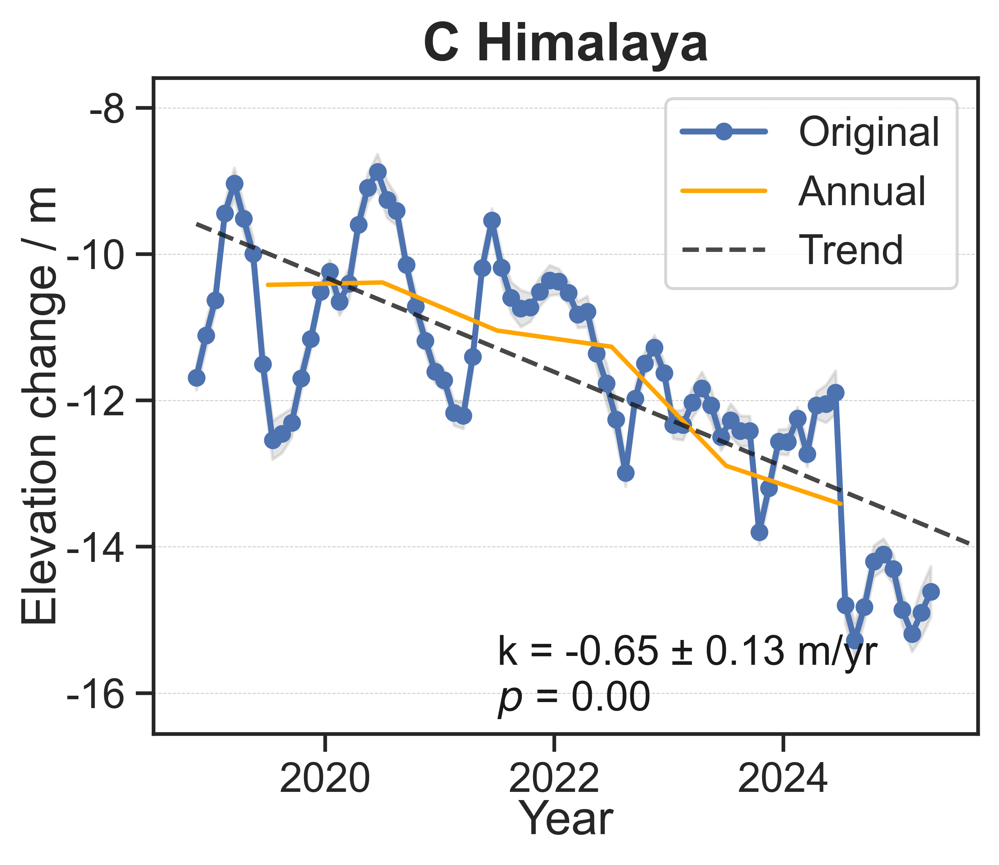

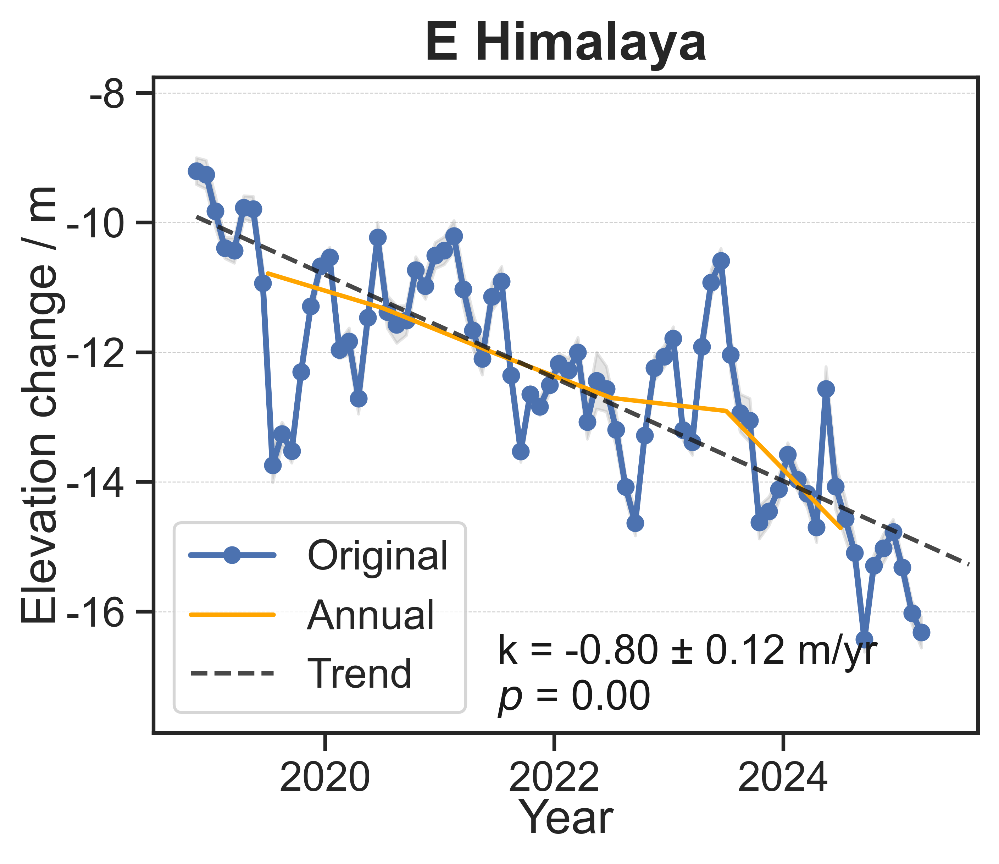

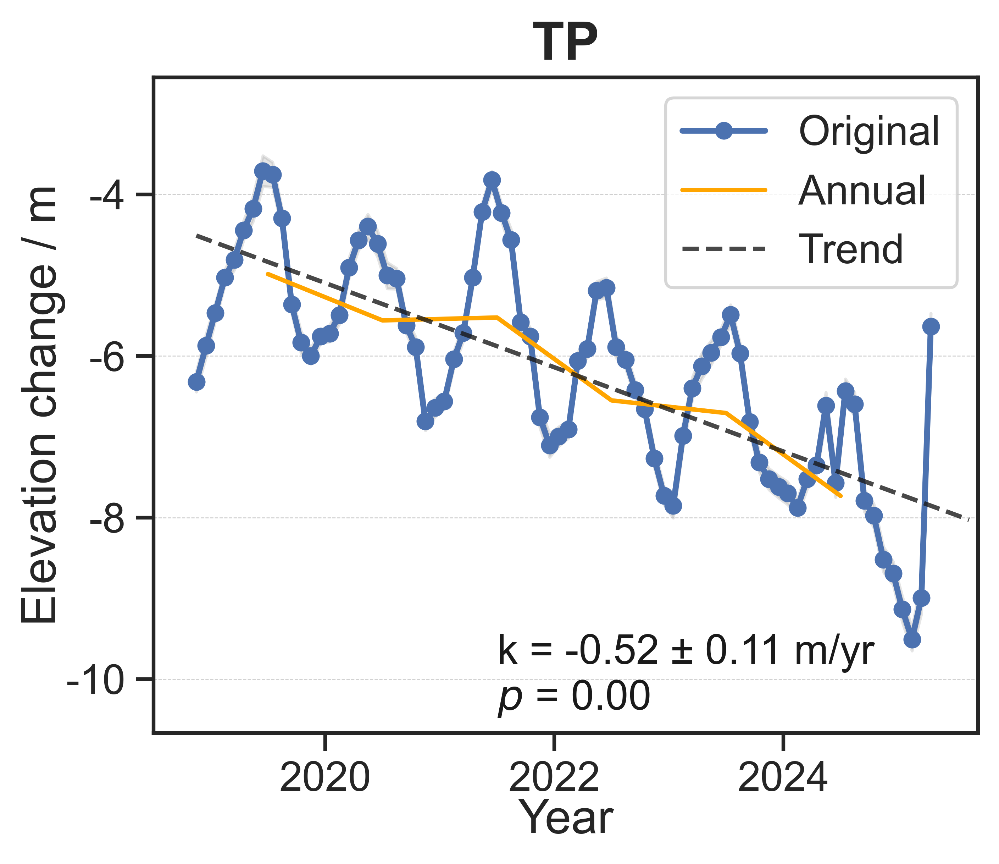

In [151]:
# 示例3：批量处理所有偶数索引区域（成对）
saved_folder = r'E:\revised_NCC_data\ICESat2_result\ele_timeseries'

for i in range(len(head_ice2)):
    saved_path = os.path.join(saved_folder, f'【{i+1}】{head_ice2[i]}.pdf')
    if '/' in saved_path:
        saved_path = saved_path.replace('/', '-')
    
    if '.1' in saved_path:
        saved_path = saved_path.replace('.1', '')

    plot_icesat2_timeseries(region_index=i,
                        trend_results=trend_results,
                        ele_results=seasonal_hampel_results,
                        uncert_results=uncert_icesat2,
                        year_results=data_icesat2_year,
                        save_path=saved_path)


---

## 4. Grid-Scale Spatial Distribution Analysis (Key Module of HMA_grid_series_compute.py)

This section processes grid-scale ICESat-2 data, calculates trends, and generates spatial distribution bubble charts. This is a critical spatial visualization for the paper.

### 4.1 Grid Trend Computation (Including Hampel Filter)

In [122]:
def calculate_grid_trends(ele_grid, num_grid, start_time=None, end_time=None):
    """
    计算所有网格的ICESat-2高程变化趋势 (修改版)
    
    核心步骤：
    1. 应用数量阈值过滤（<20个观测值设为NaN）
    2. 使用Hampel滤波器去除时间序列中的异常值
    3. 鲁棒线性回归（RLM）计算趋势、p-value和95%置信区间
    
    Returns:
    --------
    pd.DataFrame
        包含每个网格趋势的DataFrame
        - 'Slope': 斜率/趋势 (m/yr)
        - 'Pvalue': p-value (显著性)
        - 'CI/2': 95%置信区间半宽度 (m/yr)
        - 'Intercept': 截距 (m)
    """
    head_grid = ele_grid.columns.tolist()[2:] # 1,2,...,496
    # 1. 应用数量阈值
    for i in head_grid:
        mask = (num_grid[i] < 20) | (ele_grid[i] == 0)
        ele_grid.loc[mask, i] = np.nan
    
    # 初始化 results DataFrame
    results = pd.DataFrame(
        index=head_grid, 
        columns=['Slope', 'Pvalue', 'CI/2', 'Intercept'],
        dtype=float  # 预先指定数据类型
    )
    
    ele_grid_copy = ele_grid.copy()
    hampel_results = ele_grid.copy()
    hampel_results[head_grid] = np.nan
    if start_time is not None:
        ele_grid_copy = ele_grid_copy[(ele_grid_copy['date']>=start_time) & (ele_grid_copy['date']<end_time)]
        
    for i in head_grid:
        valid_data = ele_grid_copy[[i, 'days']].dropna()
        
        if len(valid_data) < 15:
            continue
        
        grid = valid_data
        year = grid['days']
        dh = grid[i]
        
        # 2. Hampel滤波器去除异常值
        hamp_series = hampel(dh, window_size=8, n=3, imputation=True)
        hamp_series = hamp_series.astype(float)
        
        # 3. 鲁棒线性回归 (RLM)
        X = sm.add_constant(year)
        y = hamp_series
        
        rlm_model = RLM(y, X, M=sm.robust.norms.HuberT())
        rlm_results = rlm_model.fit()

        slope = rlm_results.params.iloc[1]
        intercept = rlm_results.params.iloc[0]
        pvalue = rlm_results.pvalues.iloc[1]
        
        # 计算95%置信区间
        conf_int = rlm_results.conf_int(alpha=0.05)
        # conf_int 是一个 DataFrame，[1] 是斜率的置信区间
        CI_half_width = (conf_int.iloc[1, 1] - conf_int.iloc[1, 0]) / 2

        results.loc[i, 'Slope'] = slope
        results.loc[i, 'Pvalue'] = pvalue
        results.loc[i, 'CI/2'] = CI_half_width
        results.loc[i, 'Intercept'] = intercept

        hampel_results.loc[hamp_series.index, i] = hamp_series
    
    return results, hampel_results

### 4.2 Grid Spatial Distribution Visualization (Bubble Chart)

In [60]:
def plot_grid_bubble_map(var, title_text, grids, save_path=None, pvalue=None):
    """
    绘制网格尺度的冰川高程变化空间分布气泡图
    
    Parameters:
    -----------
    var : str
        要显示的变量名 
        'dh19222' = 2018.10-2022.09 ICESat-2期间趋势
        'dh00201' = 2000-2020 长期趋势
    save_path : str, optional
        图片保存路径
    
    可视化特点：
    - 使用Albers等积投影保持面积准确性
    - 气泡大小表示冰川面积
    - 颜色表示高程变化速率
    - 包含消融/积累/无观测统计饼图
    """
    # 设置底图
    arcgis_url = ('https://server.arcgisonline.com/arcgis/rest/services/'
                  'World_Terrain_Base/MapServer/tile/{z}/{y}/{x}.jpg')
    tiles = cimgt.GoogleTiles(url=arcgis_url)
    
    fig = plt.figure(figsize=(18, 12))
    
    # 使用Albers等积投影
    map_proj = ccrs.AlbersEqualArea(
        central_longitude=87.5, 
        central_latitude=34.7,
        standard_parallels=(24.5, 47.5)
    )
    
    ax = fig.add_subplot(1, 1, 1, projection=map_proj)
    extent = [63.6, 108.3, 24.5, 47.5]
    ax.set_extent(extent, crs=ccrs.PlateCarree())
    
    # 添加底图和特征
    ax.add_image(tiles, 9)
    ax.add_feature(cfeat.RIVERS.with_scale('10m'), linewidth=2, zorder=1)
    ax.add_feature(cfeat.LAKES.with_scale('10m'), zorder=1)
    
    # 绘制边界
    studyregion.plot(ax=ax, color="none", edgecolor="maroon", 
                      linewidth=3, transform=ccrs.PlateCarree(), zorder=2)
    subregion.plot(ax=ax, color="none", edgecolor="maroon", 
                    linewidth=2, transform=ccrs.PlateCarree(), zorder=5)
    
    # 设置色标（红-白-蓝）
    colors = [plt.cm.bwr(255), plt.cm.bwr(127), plt.cm.bwr(0)]
    nodes = [0, 0.66666666, 1]  # 白色偏向蓝色（积累区）
    colormap = mcolors.LinearSegmentedColormap.from_list('cmap', list(zip(nodes, colors)))

    if pvalue is not None:
        grids = grids[~(grids[var.replace('k_', 'p_')]>pvalue)]#把p<=0.05和无观测的全保留下来
    
    # 处理无观测数据
    grids_copy = grids.copy()
    mask = (grids_copy[var] == 0) | (pd.isna(grids_copy[var]))
    grids_copy["Area"][mask] = 0
    
    # 绘制散点
    plt.scatter(grids_copy['x'], grids_copy['y'], s=grids_copy["Area"], c=grids_copy[var],
                transform=ccrs.PlateCarree(), cmap=colormap, 
                vmin=-1, vmax=0.5, edgecolor='k', zorder=2)
    
    ax.grid('both', linestyle='--', linewidth=0.5)
    
    # 添加文本标签
    plt.text(x=63.5, y=31.3, s='Glacier area', rotation=0, ha='left', 
                va='baseline', transform=ccrs.PlateCarree(), 
                fontdict=dict(fontsize=25, color='k', family='Arial', weight='normal'))
    plt.text(x=107.6, y=38.5, s='Elevation change rate', rotation=90, 
                ha='left', va='baseline', transform=ccrs.PlateCarree(), 
                fontdict=dict(fontsize=25, color='k', family='Arial', weight='normal'))
    
    plt.text(x=65.9, y=30.6, s='(km$^2$)', rotation=0, ha='left', va='baseline',
             transform=ccrs.PlateCarree(), 
             fontdict=dict(fontsize=25, color='k', family='Arial', weight='normal'))
    plt.text(x=110, y=41.2, s='(m/yr)', rotation=90, ha='left', va='baseline',
             transform=ccrs.PlateCarree(), 
             fontdict=dict(fontsize=25, color='k', family='Arial', weight='normal'))
    
    # 标题
    t = plt.text(x=56.7, y=45, s=title_text, rotation=0, ha='left', va='baseline',
                 transform=ccrs.PlateCarree(), 
                 fontdict=dict(fontsize=27, color='k', family='Arial', weight='normal'))
    t.set_bbox(dict(facecolor='white', alpha=0.5, edgecolor='white'))
    
    # 坐标网格
    gl = ax.gridlines(draw_labels=True, linestyle=":", linewidth=0.3, 
                       x_inline=False, y_inline=False, color='k')
    gl.top_labels = True
    gl.right_labels = True
    gl.bottom_labels = False
    gl.left_labels = False
    gl.xformatter = LONGITUDE_FORMATTER
    gl.yformatter = LATITUDE_FORMATTER
    gl.xlocator = mticker.FixedLocator(np.arange(65, 108, 10))
    gl.ylocator = mticker.FixedLocator(np.arange(25, 47, 5))
    gl.xlabel_style = {'size': 23}
    gl.ylabel_style = {'size': 23}
    
    # 色标
    position = fig.add_axes([0.75, 0.61, 0.015, 0.22])
    b = plt.colorbar(ax=ax, cax=position, extend='neither', 
                      orientation='vertical', shrink=0.3)
    ax2 = b.ax
    ax2.yaxis.set_ticks_position('left')
    ax2.tick_params(labelsize=23, left=True, right=True)
    
    # 图例标记
    marker1 = ax.scatter([], [], s=50, c='k', alpha=0.3)
    marker2 = ax.scatter([], [], s=500, c='k', alpha=0.3)
    marker3 = ax.scatter([], [], s=1000, c='k', alpha=0.3)
    marker4 = ax.scatter([], [], s=2000, c='k', alpha=0.3)
    ax.legend(handles=[marker1, marker2, marker3, marker4], 
              labels=['50', '500', '1000', '2000'], 
              scatterpoints=1, frameon=False, fontsize=23, 
              labelspacing=1.35, handletextpad=1,
              bbox_to_anchor=(0.198, 0.325), ncol=1, 
              facecolor="white", edgecolor="None")
    
    # 统计饼图
    ablation = grids['Area'][grids_copy[var] < 0].sum()
    accumulation = grids['Area'][grids_copy[var] > 0].sum()
    nobservation = grids['Area'][grids_copy['Area'] == 0].sum()

    nobservation_ratio = nobservation/(ablation+accumulation+nobservation)*100 #%
    if nobservation_ratio >= 0.5:
        ax1 = fig.add_axes([0.16, 0.63, 0.2, 0.2])
        plt.pie(x=[ablation, accumulation, nobservation],
                labels=None,
                colors=[plt.cm.bwr(235), plt.cm.bwr(30), "white"],
                autopct='%.0f%%',
                explode=(0.2, 0.1, 0.1),
                textprops={'color': 'k', 'fontsize': 20, 
                        'fontfamily': 'Arial', 'fontweight': 'bold'},
                wedgeprops={'edgecolor': 'k', 'linestyle': '--', 'alpha': 0.9})
    else:
        ax1 = fig.add_axes([0.16, 0.63, 0.2, 0.2])
        plt.pie(x=[ablation, accumulation],
                labels=None,
                colors=[plt.cm.bwr(235), plt.cm.bwr(30)],
                autopct='%.0f%%',
                explode=(0.2, 0.1),
                textprops={'color': 'k', 'fontsize': 20, 
                        'fontfamily': 'Arial', 'fontweight': 'bold'},
                wedgeprops={'edgecolor': 'k', 'linestyle': '--', 'alpha': 0.9})
    ax1.set_facecolor("gray")
    
    if save_path:
        plt.savefig(save_path, dpi=600, bbox_inches='tight')
    
    plt.show()
    #return fig


### 4.3 Plot ICESat-2 Grid Spatial Distribution (2018 to 2025)

In [ ]:
grids.index = ele_grid.columns.tolist()[2:]
if np.isin(['k_18to25', 'p_18to25', 'CIhalf_18to25'], grids.columns).any():
    pass
else:
    grid_trends,_ = calculate_grid_trends(ele_grid, num_grid) # ele_grid中的0用nan填充了, m/yr
    grid_trends.columns = ['k_18to25', 'p_18to25', 'CIhalf_18to25','b_18to25']

    grids = pd.concat([grids, grid_trends], axis=1)
grids

,y,Area,x,pdd,pdd_corr,pdd_jiang,dh_all,dh_allcor,id,dh0020,...,coreg_vs_1,coreg_xs_1,coreg_ys_1,geometry,k_18to25,p_18to25,CIhalf_18to25,k_18to23,p_18to23,CIhalf_18to23
1,27.6415,0.0000,102.1070,4.155527,0.00000,0.000000,0.000000,0.00000,1,0.00000,...,0.269653,12.392896,-22.389823,"POLYGON ((102.0653 27, 102 27, 102 28, 102.424...",NaN,NaN,NaN,NaN,NaN,NaN
2,30.5000,512.1670,90.5000,4.305620,3.15134,2.084730,-3.909790,-7.06113,2,-8.91566,...,0.039551,13.992089,-12.842095,"POLYGON ((91 30, 90 30, 90 31, 91 31, 91 30))",-1.174450,4.404497e-122,0.097966,-1.071931,1.800545e-32,0.177072
3,26.8968,0.0000,90.5124,3.992257,0.00000,0.000000,0.000000,0.00000,3,0.00000,...,0.118286,10.313449,-15.204489,"POLYGON ((91 27, 91 26.7814, 90.9629 26.7802, ...",NaN,NaN,NaN,NaN,NaN,NaN
4,45.2123,16.7544,79.4945,-6.227410,-3.11918,0.000000,-10.589300,-7.47012,4,-10.20870,...,-0.314026,11.374880,-10.397242,"POLYGON ((79.0739 45.4498, 79.554 45.4116, 80 ...",-0.683727,6.219282e-09,0.230621,0.189028,2.309828e-01,0.309299
5,41.5000,659.4700,78.5000,6.269127,3.78460,3.811520,-3.377860,-7.16246,5,-8.96737,...,0.538818,10.216806,-17.007171,"POLYGON ((79 41, 78 41, 78 42, 79 42, 79 41))",-0.457181,4.078279e-25,0.086555,-0.283577,9.142146e-05,0.142065
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
492,34.5000,412.8380,75.5000,-0.337411,-1.75128,0.999016,-9.660970,-7.90969,492,-4.54757,...,-0.143799,10.587047,-15.725570,"POLYGON ((76 34, 75 34, 75 35, 76 35, 76 34))",-1.053857,1.869033e-16,0.250969,-1.008630,6.414512e-04,0.579143
493,37.2473,0.0000,77.4382,1.978384,0.00000,0.000000,0.000000,0.00000,493,0.00000,...,-0.144287,11.816457,-11.976747,"POLYGON ((78 37, 77 37, 77 37.6617, 77.2555 37...",NaN,NaN,NaN,NaN,NaN,NaN
494,27.5000,102.9040,90.5000,4.327192,3.73339,0.000000,-16.725100,-20.45850,494,-21.13840,...,-0.042480,11.738170,-16.012244,"POLYGON ((91 27, 90 27, 90 28, 91 28, 91 27))",-1.548444,1.196283e-11,0.447581,-0.624107,1.839363e-02,0.518845
495,30.5000,127.1690,86.5000,4.349197,3.41028,3.236200,-0.877727,-4.28801,495,-6.41198,...,-0.046875,13.248154,-13.925485,"POLYGON ((87 30, 86 30, 86 31, 87 31, 87 30))",-0.841177,4.613046e-43,0.119841,-0.671231,3.380618e-09,0.222530


C:\Users\Administrator\AppData\Local\Temp\ipykernel_30332\3324611472.py:60: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  grids_copy["Area"][mask] = 0
C:\Users\Administrator\AppData\Local\Temp\ipykernel_30332\3324611472.py:60: SettingWithCop

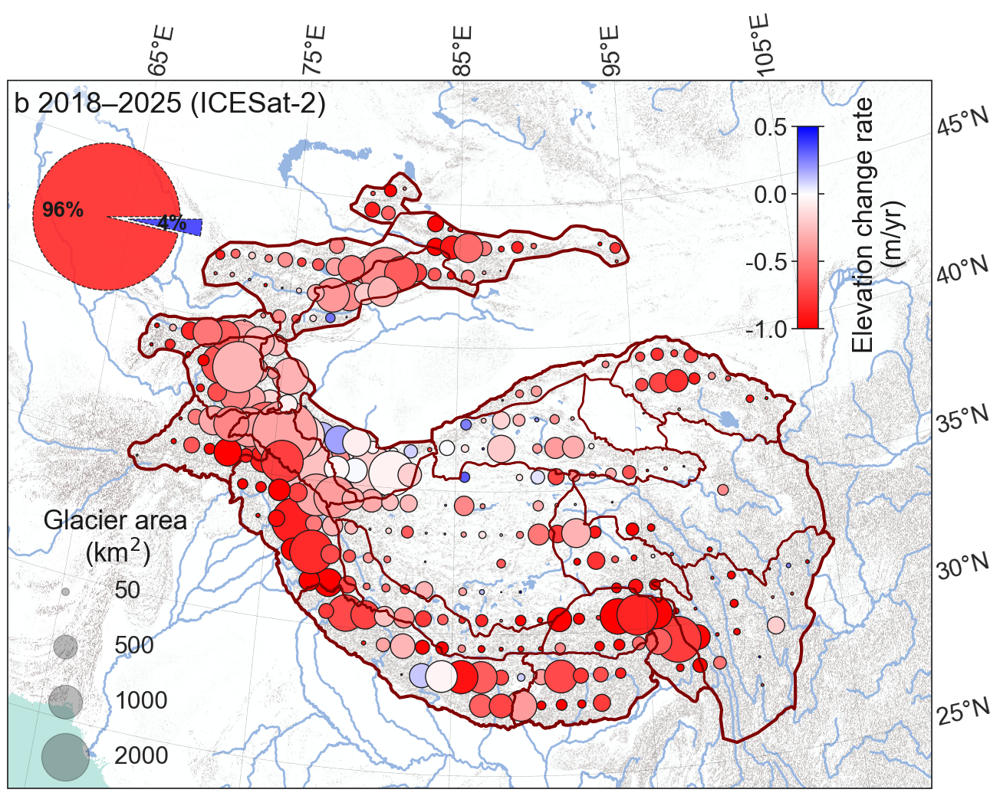

In [76]:
plot_grid_bubble_map(
     var='k_18to25',
     title_text='b 2018–2025 (ICESat-2)',
     grids=grids,
     save_path=r'E:\revised_NCC_data\ICESat2_result\ele_changerate\ele_changerate_18to25.pdf',
)

C:\Users\Administrator\AppData\Local\Temp\ipykernel_30332\3324611472.py:60: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  grids_copy["Area"][mask] = 0
C:\Users\Administrator\AppData\Local\Temp\ipykernel_30332\3324611472.py:60: SettingWithCop

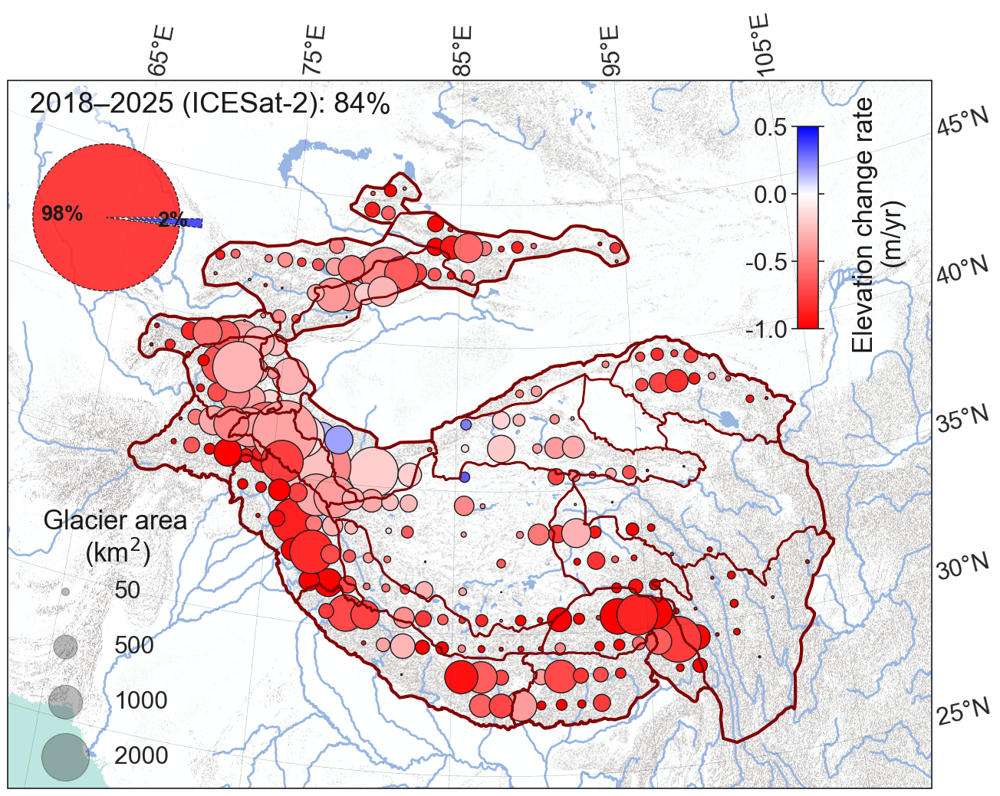

In [77]:
plot_grid_bubble_map(
     var='k_18to25',
     title_text=f'  2018–2025 (ICESat-2): {(grids['p_18to25']<0.05).sum()/(grids['p_18to25'].notna().sum())*100:.0f}%',
     grids=grids,
     save_path=r'E:\revised_NCC_data\ICESat2_result\ele_changerate\ele_signif_changerate_18to25.pdf',
     pvalue=0.05,
)
# title的比例是对有观测的网格考虑的，显著的网格的占比
# pie考虑的是非不显著的网格，即包括nan和显著的网格中的冰川面积

### 4.4 ICESat2 (2018 to 2023)

In [ ]:
grids.index = ele_grid.columns.tolist()[2:]
if np.isin(['k_18to23', 'p_18to23', 'CIhalf_18to23'], grids.columns).any():
    pass
else:
    grid_trends,_ = calculate_grid_trends(ele_grid, num_grid, start_time=datetime.datetime(2018,1,1),
                                        end_time=datetime.datetime(2023,1,1)) # ele_grid中的0用nan填充了, m/yr
    grid_trends.columns = ['k_18to23', 'p_18to23', 'CIhalf_18to23','b_18to25']

    grids = pd.concat([grids, grid_trends], axis=1)
grids

,y,Area,x,pdd,pdd_corr,pdd_jiang,dh_all,dh_allcor,id,dh0020,...,coreg_vs_1,coreg_xs_1,coreg_ys_1,geometry,k_18to25,p_18to25,CIhalf_18to25,k_18to23,p_18to23,CIhalf_18to23
1,27.6415,0.0000,102.1070,4.155527,0.00000,0.000000,0.000000,0.00000,1,0.00000,...,0.269653,12.392896,-22.389823,"POLYGON ((102.0653 27, 102 27, 102 28, 102.424...",NaN,NaN,NaN,NaN,NaN,NaN
2,30.5000,512.1670,90.5000,4.305620,3.15134,2.084730,-3.909790,-7.06113,2,-8.91566,...,0.039551,13.992089,-12.842095,"POLYGON ((91 30, 90 30, 90 31, 91 31, 91 30))",-1.174450,4.404497e-122,0.097966,-1.071931,1.800545e-32,0.177072
3,26.8968,0.0000,90.5124,3.992257,0.00000,0.000000,0.000000,0.00000,3,0.00000,...,0.118286,10.313449,-15.204489,"POLYGON ((91 27, 91 26.7814, 90.9629 26.7802, ...",NaN,NaN,NaN,NaN,NaN,NaN
4,45.2123,16.7544,79.4945,-6.227410,-3.11918,0.000000,-10.589300,-7.47012,4,-10.20870,...,-0.314026,11.374880,-10.397242,"POLYGON ((79.0739 45.4498, 79.554 45.4116, 80 ...",-0.683727,6.219282e-09,0.230621,0.189028,2.309828e-01,0.309299
5,41.5000,659.4700,78.5000,6.269127,3.78460,3.811520,-3.377860,-7.16246,5,-8.96737,...,0.538818,10.216806,-17.007171,"POLYGON ((79 41, 78 41, 78 42, 79 42, 79 41))",-0.457181,4.078279e-25,0.086555,-0.283577,9.142146e-05,0.142065
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
492,34.5000,412.8380,75.5000,-0.337411,-1.75128,0.999016,-9.660970,-7.90969,492,-4.54757,...,-0.143799,10.587047,-15.725570,"POLYGON ((76 34, 75 34, 75 35, 76 35, 76 34))",-1.053857,1.869033e-16,0.250969,-1.008630,6.414512e-04,0.579143
493,37.2473,0.0000,77.4382,1.978384,0.00000,0.000000,0.000000,0.00000,493,0.00000,...,-0.144287,11.816457,-11.976747,"POLYGON ((78 37, 77 37, 77 37.6617, 77.2555 37...",NaN,NaN,NaN,NaN,NaN,NaN
494,27.5000,102.9040,90.5000,4.327192,3.73339,0.000000,-16.725100,-20.45850,494,-21.13840,...,-0.042480,11.738170,-16.012244,"POLYGON ((91 27, 90 27, 90 28, 91 28, 91 27))",-1.548444,1.196283e-11,0.447581,-0.624107,1.839363e-02,0.518845
495,30.5000,127.1690,86.5000,4.349197,3.41028,3.236200,-0.877727,-4.28801,495,-6.41198,...,-0.046875,13.248154,-13.925485,"POLYGON ((87 30, 86 30, 86 31, 87 31, 87 30))",-0.841177,4.613046e-43,0.119841,-0.671231,3.380618e-09,0.222530


C:\Users\Administrator\AppData\Local\Temp\ipykernel_30332\3324611472.py:60: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  grids_copy["Area"][mask] = 0
C:\Users\Administrator\AppData\Local\Temp\ipykernel_30332\3324611472.py:60: SettingWithCop

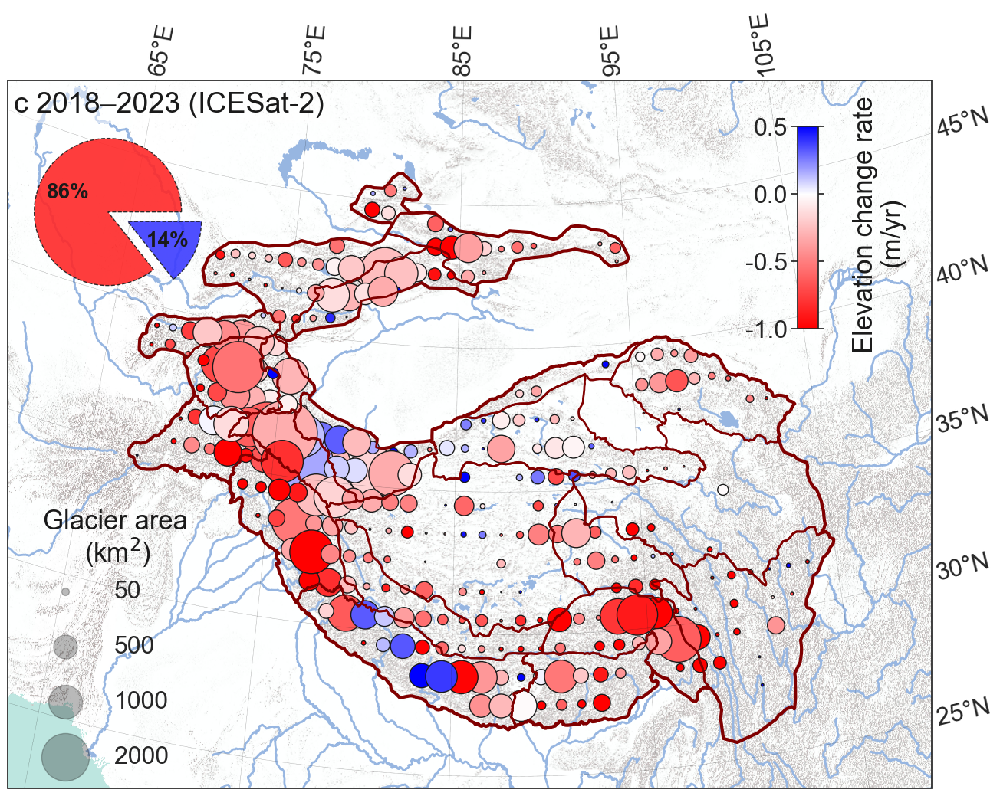

In [78]:
plot_grid_bubble_map(
     var='k_18to23',
     title_text='c 2018–2023 (ICESat-2)',
     grids=grids,
     save_path=r'E:\revised_NCC_data\ICESat2_result\ele_changerate\ele_changerate_18to23.pdf',
)

C:\Users\Administrator\AppData\Local\Temp\ipykernel_30332\3324611472.py:60: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  grids_copy["Area"][mask] = 0
C:\Users\Administrator\AppData\Local\Temp\ipykernel_30332\3324611472.py:60: SettingWithCop

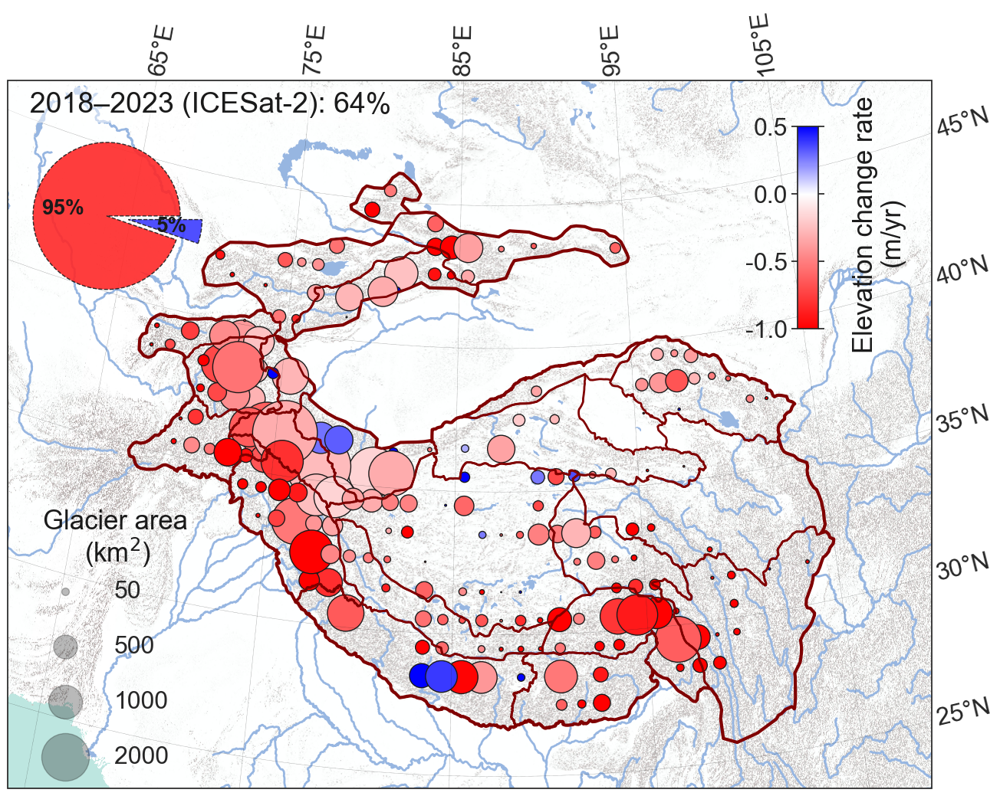

In [79]:
plot_grid_bubble_map(
     var='k_18to23',
     title_text=f'  2018–2023 (ICESat-2): {(grids['p_18to23']<0.05).sum()/(grids['p_18to23'].notna().sum())*100:.0f}%',
     grids=grids,
     save_path=r'E:\revised_NCC_data\ICESat2_result\ele_changerate\ele_signif_changerate_18to23.pdf',
     pvalue=0.05,
)

### 4.5 ICESat2 against NASADEM (2000 to 2020)

In [72]:
data_grid_ele_year = pd.read_excel(
    r"E:\revised_NCC_data\ICESat2_result\ICESat2_yearly_elevation_results.xlsx",
    sheet_name='year_value', header=0,
)
data_grid_num_year = pd.read_excel(
    r"E:\revised_NCC_data\ICESat2_result\ICESat2_yearly_elevation_results.xlsx",
    sheet_name='year_count', header=0,
)

ele_grid = data_grid_ele_year[['start_year','end_year(not included)'] + np.arange(1,497).tolist()]
num_grid = data_grid_num_year[['start_year','end_year(not included)'] + np.arange(1,497).tolist()]

idx = (ele_grid['start_year'] == 2019) & (ele_grid['end_year(not included)'] == 2022)
ele_grid_target = ele_grid.loc[idx, 1:].T
num_grid_target = num_grid.loc[idx, 1:].T

ele_grid_target.index = np.arange(1,497).tolist()
num_grid_target.index = np.arange(1,497).tolist()

In [80]:
if np.isin(['k_00to20'], grids.columns).any():
    pass
else:
    ele_grid_target.columns = ['k_00to20']
    grids = pd.concat([grids, ele_grid_target/20], axis=1)#m/yr

grids

,y,Area,x,pdd,pdd_corr,pdd_jiang,dh_all,dh_allcor,id,dh0020,...,coreg_xs_1,coreg_ys_1,geometry,k_18to25,p_18to25,CIhalf_18to25,k_18to23,p_18to23,CIhalf_18to23,k_00to20
1,27.6415,0.0000,102.1070,4.155527,0.00000,0.000000,0.000000,0.00000,1,0.00000,...,12.392896,-22.389823,"POLYGON ((102.0653 27, 102 27, 102 28, 102.424...",NaN,NaN,NaN,NaN,NaN,NaN,0.000000
2,30.5000,512.1670,90.5000,4.305620,3.15134,2.084730,-3.909790,-7.06113,2,-8.91566,...,13.992089,-12.842095,"POLYGON ((91 30, 90 30, 90 31, 91 31, 91 30))",-1.174450,4.404497e-122,0.097966,-1.071931,1.800545e-32,0.177072,-0.419007
3,26.8968,0.0000,90.5124,3.992257,0.00000,0.000000,0.000000,0.00000,3,0.00000,...,10.313449,-15.204489,"POLYGON ((91 27, 91 26.7814, 90.9629 26.7802, ...",NaN,NaN,NaN,NaN,NaN,NaN,0.000000
4,45.2123,16.7544,79.4945,-6.227410,-3.11918,0.000000,-10.589300,-7.47012,4,-10.20870,...,11.374880,-10.397242,"POLYGON ((79.0739 45.4498, 79.554 45.4116, 80 ...",-0.683727,6.219282e-09,0.230621,0.189028,2.309828e-01,0.309299,-0.246253
5,41.5000,659.4700,78.5000,6.269127,3.78460,3.811520,-3.377860,-7.16246,5,-8.96737,...,10.216806,-17.007171,"POLYGON ((79 41, 78 41, 78 42, 79 42, 79 41))",-0.457181,4.078279e-25,0.086555,-0.283577,9.142146e-05,0.142065,-0.528299
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
492,34.5000,412.8380,75.5000,-0.337411,-1.75128,0.999016,-9.660970,-7.90969,492,-4.54757,...,10.587047,-15.725570,"POLYGON ((76 34, 75 34, 75 35, 76 35, 76 34))",-1.053857,1.869033e-16,0.250969,-1.008630,6.414512e-04,0.579143,-0.261988
493,37.2473,0.0000,77.4382,1.978384,0.00000,0.000000,0.000000,0.00000,493,0.00000,...,11.816457,-11.976747,"POLYGON ((78 37, 77 37, 77 37.6617, 77.2555 37...",NaN,NaN,NaN,NaN,NaN,NaN,0.000000
494,27.5000,102.9040,90.5000,4.327192,3.73339,0.000000,-16.725100,-20.45850,494,-21.13840,...,11.738170,-16.012244,"POLYGON ((91 27, 90 27, 90 28, 91 28, 91 27))",-1.548444,1.196283e-11,0.447581,-0.624107,1.839363e-02,0.518845,-1.031677
495,30.5000,127.1690,86.5000,4.349197,3.41028,3.236200,-0.877727,-4.28801,495,-6.41198,...,13.248154,-13.925485,"POLYGON ((87 30, 86 30, 86 31, 87 31, 87 30))",-0.841177,4.613046e-43,0.119841,-0.671231,3.380618e-09,0.222530,-0.305873


C:\Users\Administrator\AppData\Local\Temp\ipykernel_30332\3324611472.py:60: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  grids_copy["Area"][mask] = 0
C:\Users\Administrator\AppData\Local\Temp\ipykernel_30332\3324611472.py:60: SettingWithCop

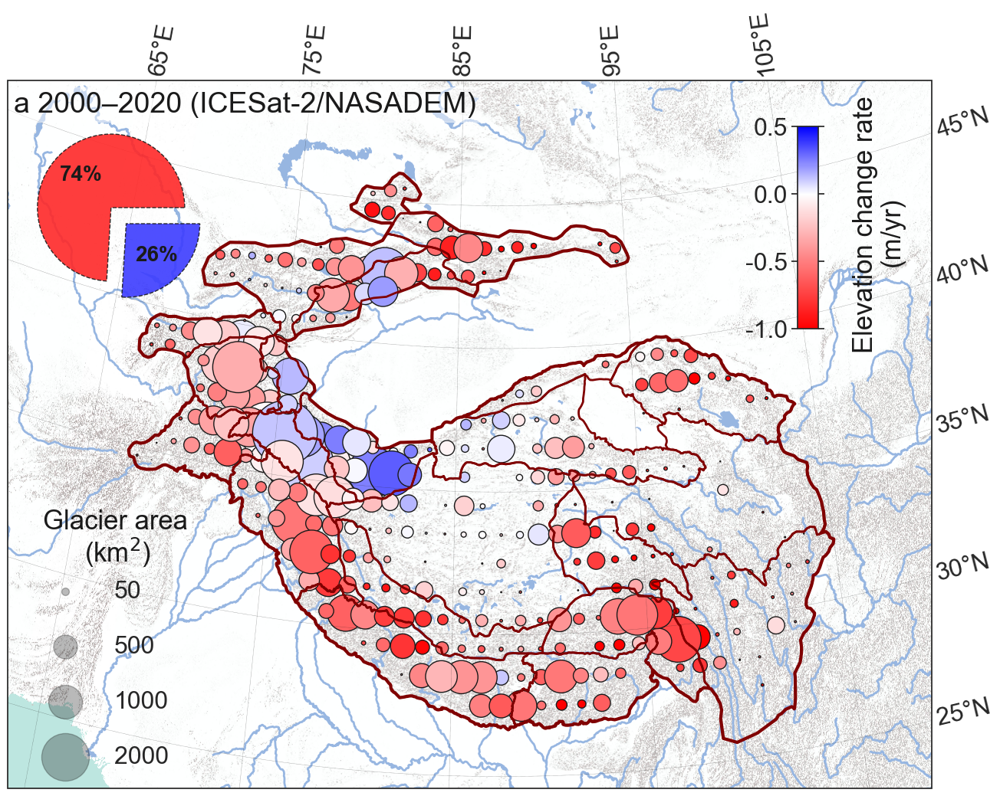

In [82]:
plot_grid_bubble_map(
     var='k_00to20',
     title_text='a 2000–2020 (ICESat-2/NASADEM)',
     grids=grids,
     save_path=r'E:\revised_NCC_data\ICESat2_result\ele_changerate\ele_changerate_00to20.pdf',
)

### 4.6 2018-2025 vs. 2018-2023

(-5.0, 5.0)

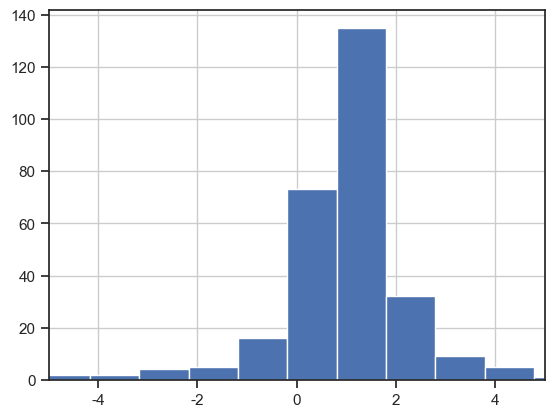

In [88]:
if '1825vs1823' in grids.columns:
    pass
else:
    grids['1825vs1823'] = grids['k_18to25']/grids['k_18to23']

grids['1825vs1823'].hist(bins=50)
plt.xlim(-5,5)

In [102]:
def plot_grid_bubble_map2(var, var2, var3, title_text, grids, save_path=None):
    '''
    var:
    var2/var3
    '''
    # 设置底图
    arcgis_url = ('https://server.arcgisonline.com/arcgis/rest/services/'
                  'World_Terrain_Base/MapServer/tile/{z}/{y}/{x}.jpg')
    tiles = cimgt.GoogleTiles(url=arcgis_url)
    
    fig = plt.figure(figsize=(18, 12))
    
    # 使用Albers等积投影
    map_proj = ccrs.AlbersEqualArea(
        central_longitude=87.5, 
        central_latitude=34.7,
        standard_parallels=(24.5, 47.5)
    )
    
    ax = fig.add_subplot(1, 1, 1, projection=map_proj)
    extent = [63.6, 108.3, 24.5, 47.5]
    ax.set_extent(extent, crs=ccrs.PlateCarree())
    
    # 添加底图和特征
    ax.add_image(tiles, 9)
    ax.add_feature(cfeat.RIVERS.with_scale('10m'), linewidth=2, zorder=1)
    ax.add_feature(cfeat.LAKES.with_scale('10m'), zorder=1)
    
    # 绘制边界
    studyregion.plot(ax=ax, color="none", edgecolor="maroon", 
                      linewidth=3, transform=ccrs.PlateCarree(), zorder=2)
    subregion.plot(ax=ax, color="none", edgecolor="maroon", 
                    linewidth=2, transform=ccrs.PlateCarree(), zorder=5)
    
    # define four colors
    light_red = '#FF9999'  # 浅红
    light_blue = '#ABD8E5' # 浅蓝
    dark_red = '#D15354'   # 深红
    dark_blue = '#5094DE'  # 深蓝
    color_choices = [light_red, light_blue, dark_red, dark_blue]
    
    grids_copy = grids.copy()
    obs_idx = (grids_copy[var].notna()) & (grids_copy[var] != 0) & (grids_copy[var3] != 0)
    grids_valid = grids_copy[obs_idx] #被观测到的网格

    conditions = [
        (grids_valid[var].abs() <= 1) & (grids_valid[var2] < 0),
        (grids_valid[var].abs() <= 1) & (grids_valid[var2] > 0),
        (grids_valid[var].abs() > 1) & (grids_valid[var2] < 0),
        (grids_valid[var].abs() > 1) & (grids_valid[var2] > 0)
    ]
    grids_valid['plot_color'] = np.select(conditions, color_choices, default='grey')
    
    # 绘制散点
    grids1 = grids_valid[grids_valid[var]>0]
    plt.scatter(grids1['x'], grids1['y'], s=grids1["Area"], c=grids1['plot_color'],
                transform=ccrs.PlateCarree(), marker='o', alpha=1,
                edgecolor='k', zorder=2)
    
    grids2 = grids_valid[grids_valid[var]<0] #发生了变号
    plt.scatter(grids2['x'], grids2['y'], s=grids2["Area"], c=grids2['plot_color'],
                transform=ccrs.PlateCarree(), marker='D', alpha=1,
                edgecolor='k', zorder=2)
    
    ax.grid('both', linestyle='--', linewidth=0.5)
    
    # 添加文本标签
    plt.text(x=63.5, y=31.3, s='Glacier area', rotation=0, ha='left', 
                va='baseline', transform=ccrs.PlateCarree(), 
                fontdict=dict(fontsize=25, color='k', family='Arial', weight='normal'))
    
    plt.text(x=65.9, y=30.6, s='(km$^2$)', rotation=0, ha='left', va='baseline',
             transform=ccrs.PlateCarree(), 
             fontdict=dict(fontsize=25, color='k', family='Arial', weight='normal'))
    
    # 标题
    t = plt.text(x=56.7, y=45, s=title_text, rotation=0, ha='left', va='baseline',
                 transform=ccrs.PlateCarree(), 
                 fontdict=dict(fontsize=27, color='k', family='Arial', weight='normal'))
    t.set_bbox(dict(facecolor='white', alpha=0.5, edgecolor='white'))
    
    # 坐标网格
    gl = ax.gridlines(draw_labels=True, linestyle=":", linewidth=0.3, 
                       x_inline=False, y_inline=False, color='k')
    gl.top_labels = True
    gl.right_labels = True
    gl.bottom_labels = False
    gl.left_labels = False
    gl.xformatter = LONGITUDE_FORMATTER
    gl.yformatter = LATITUDE_FORMATTER
    gl.xlocator = mticker.FixedLocator(np.arange(65, 108, 10))
    gl.ylocator = mticker.FixedLocator(np.arange(25, 47, 5))
    gl.xlabel_style = {'size': 23}
    gl.ylabel_style = {'size': 23}
    
    # 图例标记
    marker1 = ax.scatter([], [], s=50, c='k', alpha=0.3)
    marker2 = ax.scatter([], [], s=500, c='k', alpha=0.3)
    marker3 = ax.scatter([], [], s=1000, c='k', alpha=0.3)
    marker4 = ax.scatter([], [], s=2000, c='k', alpha=0.3)
    ax.legend(handles=[marker1, marker2, marker3, marker4], 
              labels=['50', '500', '1000', '2000'], 
              scatterpoints=1, frameon=False, fontsize=23, 
              labelspacing=1.35, handletextpad=1,
              bbox_to_anchor=(0.198, 0.325), ncol=1, 
              facecolor="white", edgecolor="None")
    
    # 统计饼图
    light_red_proportion = grids_valid['Area'][grids_valid['plot_color']==light_red].sum()
    light_blue_proportion = grids_valid['Area'][grids_valid['plot_color']==light_blue].sum()
    dark_red_proportion = grids_valid['Area'][grids_valid['plot_color']==dark_red].sum()
    dark_blue_proportion = grids_valid['Area'][grids_valid['plot_color']==dark_blue].sum()

    nobservation_area = grids_copy['Area'][~obs_idx].sum()

    nobservation_ratio = nobservation_area/(grids_copy['Area'].sum())*100 #%
    if nobservation_ratio >= 0.5:
        ax1 = fig.add_axes([0.16, 0.63, 0.2, 0.2])
        plt.pie(x=[light_red_proportion, light_blue_proportion, dark_red_proportion, dark_blue_proportion, nobservation_area],
                labels=None,
                colors=[light_red, light_blue, dark_red, dark_blue, "white"],
                autopct='%.0f%%',
                explode=(0., 0, 0, 0, 0),
                textprops={'color': 'k', 'fontsize': 20, 
                        'fontfamily': 'Arial', 'fontweight': 'bold'},
                wedgeprops={'edgecolor': 'k', 'linestyle': '--', 'alpha': 1})
    else:
        ax1 = fig.add_axes([0.16, 0.63, 0.2, 0.2])
        plt.pie(x=[light_red_proportion, light_blue_proportion, dark_red_proportion, dark_blue_proportion],
                labels=None,
                colors=[light_red, light_blue, dark_red, dark_blue],
                autopct='%.0f%%',
                explode=(0., 0, 0, 0),
                textprops={'color': 'k', 'fontsize': 20, 
                        'fontfamily': 'Arial', 'fontweight': 'bold'},
                wedgeprops={'edgecolor': 'k', 'linestyle': '--', 'alpha': 1})
    ax1.set_facecolor("gray")
    print(f'- -> +: {grids2['Area'][grids2[var2]>0].sum()/(grids_copy['Area'].sum())*100:.2f} %')
    print(f'+ -> -: {grids2['Area'][grids2[var2]<0].sum()/(grids_copy['Area'].sum())*100:.2f} %')
    print(f'        magnitude increase: {grids2['Area'][(grids2[var2]<0) & (grids2[var]>1)].sum()/(grids_copy['Area'].sum())*100:.2f} %')
    print(f'        magnitude decrease: {grids2['Area'][(grids2[var2]<0) & (grids2[var]<1)].sum()/(grids_copy['Area'].sum())*100:.2f} %')
    
    if save_path:
        plt.savefig(save_path, dpi=600, bbox_inches='tight')
    
    plt.show()
    #return fig


d:\Anaconda\install\envs\gee_dask\Lib\site-packages\geopandas\geodataframe.py:1819: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


- -> +: 0.04 %
+ -> -: 10.67 %
        magnitude increase: 0.00 %
        magnitude decrease: 10.67 %


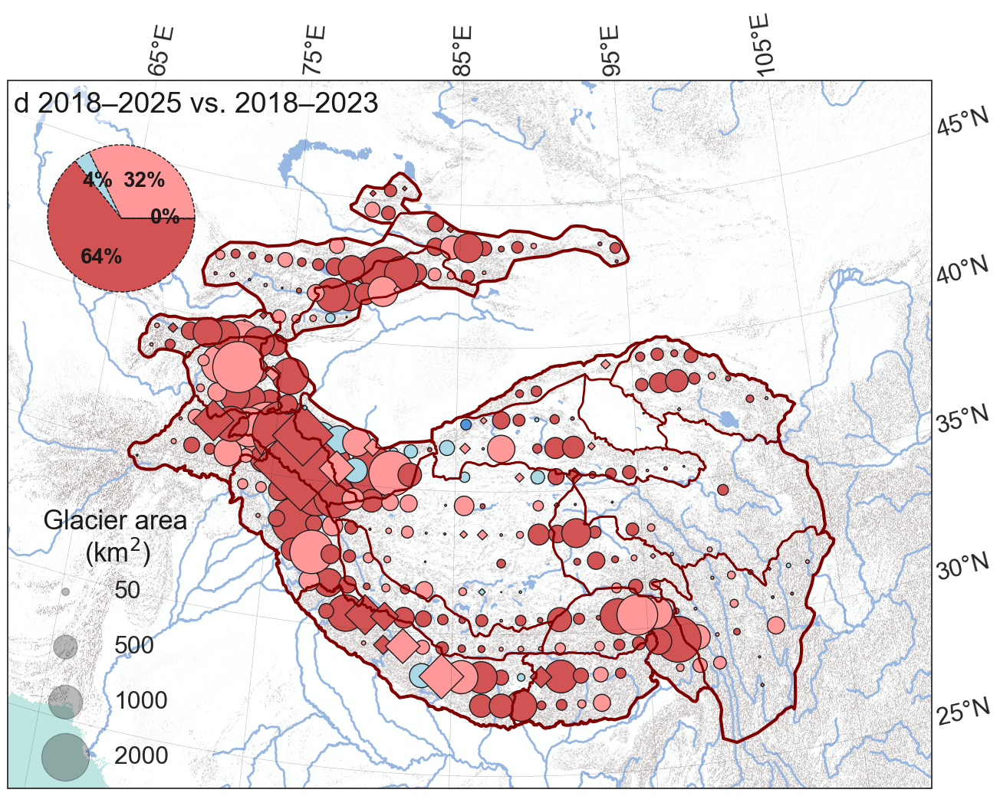

In [103]:
plot_grid_bubble_map2(
     var='1825vs1823',
     var2='k_18to25',
     var3='k_18to23',
     title_text='d 2018–2025 vs. 2018–2023',
     grids=grids,
     save_path=r'E:\revised_NCC_data\ICESat2_result\ele_changerate\ele_compare_1825vs1823.pdf',
)

## 5. Elevation Band Analysis Module (Core Content of elevation_band_plot.py)

This section analyzes ICESat-2 glacier elevation changes across different elevation bands, demonstrating altitude-dependent mass balance patterns.

### 5.1 Analysis of Interannual Changes by Elevation Band

In [247]:
# 高度带数据已在前面加载，这里定义绘图函数
def plot_elevation_band_analysis(region_name, data_elev, area_ele, save_path=None):
    """
    绘制特定区域的高度带年际变化分析
    
    Parameters:
    -----------
    region_name : str
    save_path : str, optional
        保存路径
    
    特点：
    - 展示2019-2024年的高度带变化
    - 双Y轴：高程变化和冰川面积
    - 可选局部放大图（inset）
    """
    years = data_elev.columns.tolist()[1:]
    # 高度带面积加权后的dh
    dh_year = []
    for year in years:
        elei = data_elev[year]
        areai = area_ele[region_name]

        valid_idx = (elei != 0) & (areai != 0)
        if np.sum(valid_idx) == 0:
            dh_year.append(np.nan)
        else:
            dh = np.average(elei[valid_idx], weights=areai[valid_idx])
            dh_year.append(dh)
        
    data_elev_copy = data_elev.copy()
    data_elev_copy = data_elev_copy.replace(0, np.nan)
    
    valid_idx = areai > 20
    if np.sum(valid_idx) < 5:
        return None
    valid_data_elev = data_elev_copy.loc[valid_idx, :]
    valid_area = areai[valid_idx]
    
    # 创建图形
    fig, ax = plt.subplots(figsize=(5, 4))
    
    # 绘制不同年份
    for i, year in enumerate(years):
        selected_dh = dh_year[i]
        if not pd.isna(selected_dh):
            color_num = i
            if color_num>=3:
                color_num+=1
            ax.plot(valid_data_elev['ele_center'], valid_data_elev[year], '.-', color=plt.cm.Accent(color_num), 
                    linewidth=2, label=f'{int(year)}: {selected_dh:.2f} m', alpha=0.8)
    
    plt.grid(axis='y', linestyle='--', linewidth=0.3)
    ax.legend(ncol=2, fontsize=12)
    ax.set_ylabel(r'Elevation change / m', fontsize=16, labelpad=0)
    ax.set_xlabel(r'Elevation / m', fontsize=16, labelpad=0)
    ax.set_ylim([valid_data_elev[years].min().min(), valid_data_elev[years].max().max()+5])
    ax.set_xlim([valid_data_elev['ele_center'].min(), valid_data_elev['ele_center'].max()])
    ax.tick_params(labelsize=14)
    
    # 双Y轴：冰川面积
    ax2 = ax.twinx()
    ax.set_zorder(ax2.get_zorder() + 1)
    ax.patch.set_visible(False)
    ax2.invert_yaxis()
    ax2.bar(valid_data_elev['ele_center'], valid_area.values, color='skyblue', width=80, alpha=0.8, edgecolor='none')
    ax2.set_ylabel(r'Glacier area / km$^2$', fontsize=16, 
                   fontweight='bold', labelpad=5, color='skyblue')
    ax2.tick_params(labelsize=14)
    #ax2.tick_params(axis='y', colors='skyblue')
    #ax2.yaxis.label.set_color('skyblue')
    ax2.set_ylim([valid_area.max()*2, 0])
    
    # 设置x轴标签
    if '.1' in region_name:
        region_name = region_name.replace('.1', '')
    ax.set_title(region_name, fontsize=18, fontweight='bold')
    
    if save_path:
        fig.savefig(save_path, dpi=600, bbox_inches='tight')
    
    plt.show()

In [241]:
region_folder = r'E:\revised_NCC_data\ICESat2_result\ele_band_results'
area_ele1 = pd.read_excel(
    'E:/HMA/HMA高度带.xlsx',
    sheet_name = 'HMA_RGI_100',
    header=None, nrows=66
)
area_ele2 = pd.read_excel(
    'E:/HMA/HMA高度带.xlsx',
    sheet_name = 'HMA22_100',
    header=None, nrows=66, usecols='D:Y'
)
area_TP = pd.read_excel(
    'E:/HMA/HMA高度带.xlsx',
    sheet_name = 'HMA22_100',
    header=None, nrows=66, usecols='C'
)

area_ele = pd.concat([area_ele1, area_ele2, area_TP], axis=1)
area_ele.columns = ['ele_center'] + head_ice2

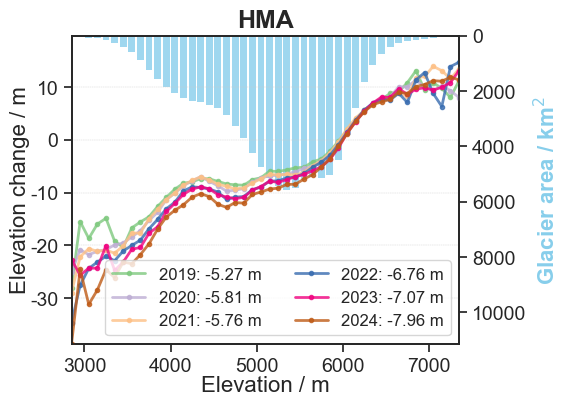

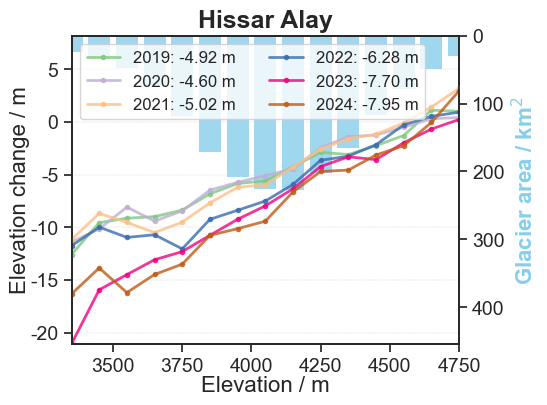

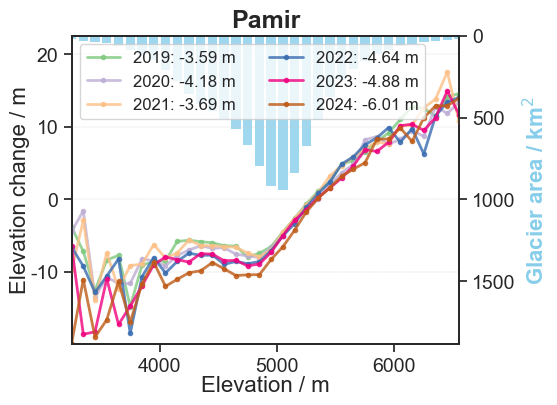

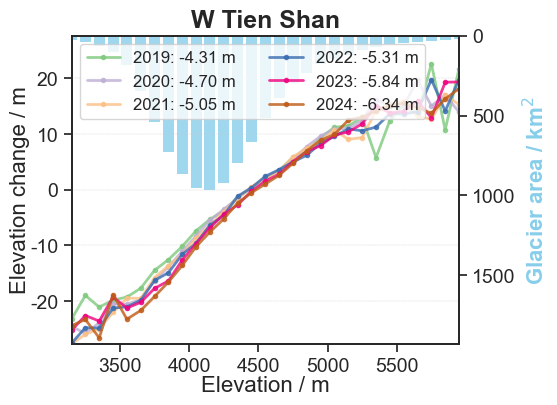

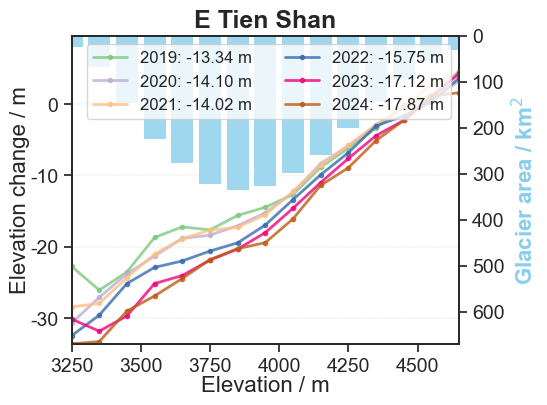

...

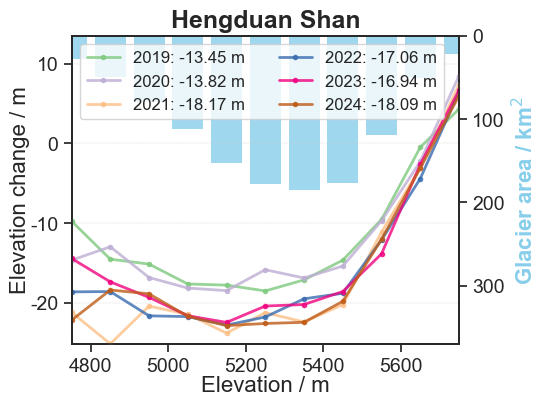

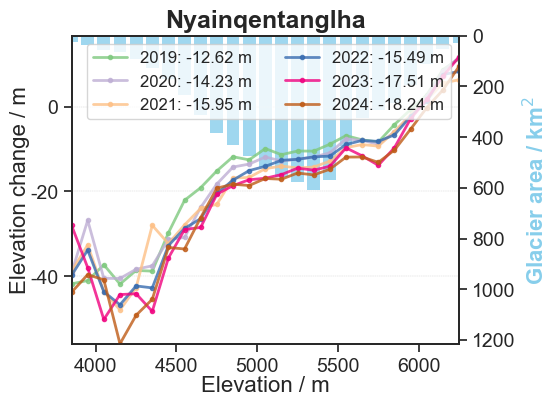

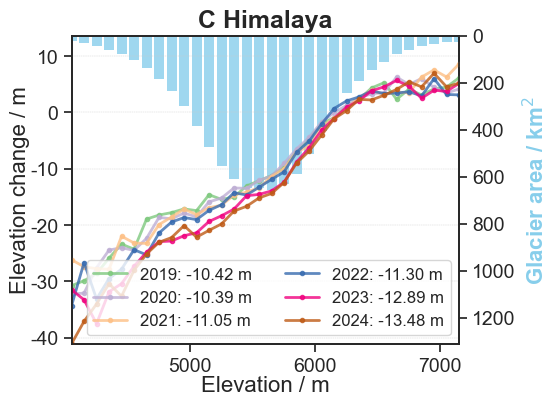

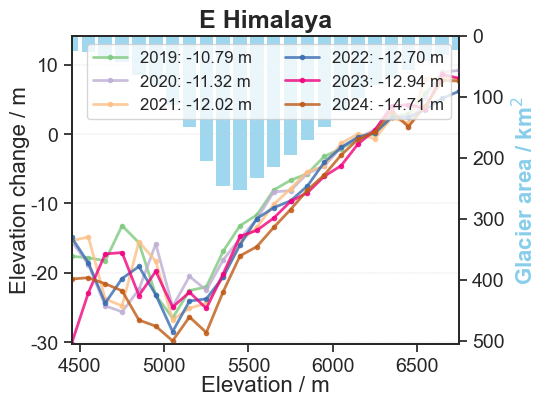

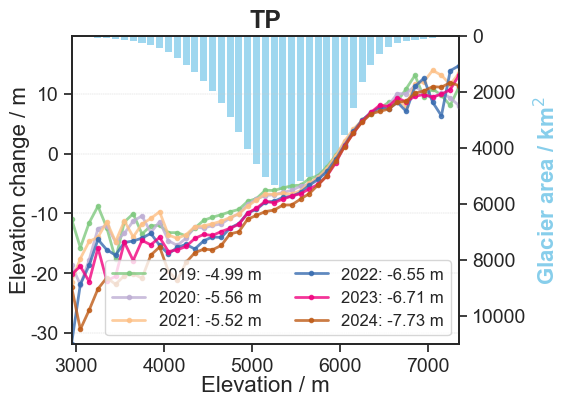

In [248]:
saved_folder = r'E:\revised_NCC_data\ICESat2_result\ele_band_results\fig_title'

for i, region_name in enumerate(head_ice2):
    region_path = os.path.join(region_folder, f'【{i+1}】{region_name}.xlsx')
    if '/' in region_path:
        region_path = region_path.replace('/', '-')
    
    if '.1' in region_path:
        region_path = region_path.replace('.1', '')
    
    data_elev = pd.read_excel(
        region_path,
        sheet_name='ele_band_value', header=2, usecols='A:G'
    )
    data_elev.rename(columns={'mid_year': 'ele_center'}, inplace=True)

    plot_elevation_band_analysis(region_name, data_elev, area_ele, 
                                    save_path=os.path.join(saved_folder, os.path.basename(region_path).replace('.xlsx', '.pdf')))